# Introduction

<p>Sur la place de marché, des vendeurs proposent des articles à des acheteurs en postant une photo et une description. Pour l'instant, l'attribution de la catégorie d'un article est effectuée manuellement par les vendeurs, et est donc peu fiable. De plus, le volume des articles est pour l’instant très petit.</p>

<p>Pour rendre l’expérience utilisateur des vendeurs (faciliter la mise en ligne de nouveaux articles) et des acheteurs (faciliter la recherche de produits) la plus fluide possible, et dans l'optique d'un passage à l'échelle, il devient nécessaire d'automatiser cette tâche.</p>

<p>L'objectif de cette mission est de réaliser une première étude de faisabilité d'un moteur de classification d'articles, basé sur une image et une description, pour l'automatisation de l'attribution de la catégorie d'un article.</p>

<p>Pour cela, il faut analyser le jeu de données en réalisant un prétraitement des descriptions des produits et des images, une réduction de dimension, puis un clustering. Les résultats de la réduction de dimension et du clustering seront à présenter sous la forme de graphiques en deux dimensions, et confirmés par un calcul de similarité entre les catégories réelles et les clusters. Ces résultats illustreront le fait que les caractéristiques extraites permettent de regrouper des produits de même catégorie.</p>

In [1]:
# Librairies personnalisées
from my_functions.common_functions import *
from my_functions.uni_bi_variate_functions import *
from my_functions.machine_learning_common_functions import *
from my_functions.dimensionality_reduction_functions import *

from sklearn.preprocessing import LabelEncoder
from IPython.display import clear_output
from sklearn import cluster, metrics
from sklearn.manifold import TSNE
from lightgbm  import LGBMClassifier

# NLP
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import nltk
import gensim
import openai
from openai.embeddings_utils import get_embedding
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Deep Learning
import tensorflow as tf
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
import tensorflow_text
from transformers import *
import tensorflow_hub as hub
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras import optimizers

# Image Processing
from tensorflow.keras.applications import EfficientNetB0, Xception, ResNet50V2, InceptionV3, MobileNetV2
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.utils import img_to_array, load_img, to_categorical, plot_model
from PIL import Image
import cv2 

# Fonctions utiles
from multiprocessing import cpu_count
import traceback
import pickle
import os
import gc
import time
import logging
logging.disable(logging.WARNING) # disable WARNING, INFO and DEBUG logging everywhere

Image.MAX_IMAGE_PIXELS = None
os.environ["TF_KERAS"]='1'

%matplotlib inline
low_memory=False # faible mémoire vive (RAM) pour gérer la lecture de gros fichiers

# 1. Chargement des Données

In [2]:
df = pd.read_csv('Flipkart/flipkart_com-ecommerce_sample_1050.csv', low_memory=low_memory)

Le data set contient :
	- 1050 lignes et 15 colonnes.
	- 341 valeurs manquantes, ce qui représente 2.17 % du data set.
Voici un sous-échantillon aléatoire :


,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
236,cf2ba696547459733c6bbfad4e3bcf62,2015-12-01 12:40:44 +0000,http://www.flipkart.com/unique-design-mobile-s...,Unique Design Mobile Stand Showpiece - 15 cm,"[""Home Decor & Festive Needs >> Showpieces >> ...",SHIE7CFT6W7DVEHG,999.0,350.0,cf2ba696547459733c6bbfad4e3bcf62.jpg,False,Unique Design Mobile Stand Showpiece - 15 cm...,No rating available,No rating available,Unique Design,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1023,b7214d4c357e3f7acae72fcbe7d31afe,2016-03-03 06:06:42 +0000,http://www.flipkart.com/transcend-premium-memo...,Transcend Premium Memory DDR2 2 GB (1x2GB) PC ...,"[""Computers >> Computer Components >> RAMs >> ...",RAMEGFGCHMH8AN8W,2999.0,1248.0,b7214d4c357e3f7acae72fcbe7d31afe.jpg,False,Specifications of Transcend Premium Memory DDR...,4.2,4.2,Transcend,"{""product_specification""=>[{""key""=>""Sales Pack..."


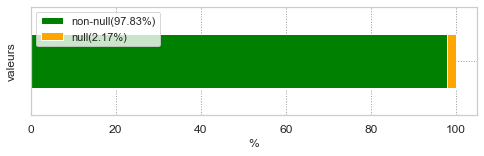

In [ ]:
verifier_taille(df)
afficher_echantillon(df)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [5]:
# Vérifier l'abscence de doublons
doublons(df['product_name'])

Series([], Name: product_name, dtype: object)

In [6]:
afficher_echantillon(df['description'], n=3).tolist()

Voici un sous-échantillon aléatoire :


['Key Features of Prisha India Craft m_jug015-1-prishaindia Water Jug At this time when the world is riddled with pollution, our countrymen are using high potency tablets even for minor problems which is spreading poision in their bodies. Our Rishes, saints and even doctors have found a very easy method to deal with such disorders. The best remedy to overcome these problems is to store water in a copper utensil overnight and drink four glasses every morning.,Prisha India Craft m_jug015-1-prishaindia Water Jug (2000 L) Price: Rs. 1,899 At this time when the world is riddled with pollution, our countrymen are using high potency tablets even for minor problems which is spreading poision in their bodies. Our Rishes, saints and even doctors have found a very easy method to deal with such disorders. The best remedy to overcome these problems is to store water in a copper utensil overnight and drink four glasses every morning.After this you can wash your mouth and brush your teeth. It is also

# 2. Segmentation basée Texte (NLP)

Dans un premier temps, on commence par étudier la segmentation des articles selon la description textuelle.

## 2.1. Nettoyage du texte

<p>Mais avant de procéder à toute analyse, il faut d’abord nettoyer les descriptions en gardant uniquement les mots (pas nombre, pas de ponctuations) pertinents (non communs à la langue et de taille non négligeable), puis garder la racine (lem) de chaque mot.</p>

In [7]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [8]:
# Nettoyage de l'arborescence des articles
df['product_category_tree'] = df['product_category_tree'].apply(lambda x : ('>>'.join([categ.split('"')[-1].strip() for categ in  x.split('>>')[:-1]])).strip())

In [9]:
# Tokenizer
from nltk.tokenize import word_tokenize
import string
import re
# Stop words
from nltk.corpus import stopwords
from stop_words import get_stop_words #pip install stop-words
stop_w = list(set(stopwords.words('english')+get_stop_words('english')))

def stop_word_filter_fct(list_words) :
    filtered_w = [w for w in list_words if not w in stop_w]
    filtered_w2 = [w for w in filtered_w if len(w) > 2]
    return filtered_w2
    
def tokenizer_fct(sentence) :
    # Retirer les ponctuations
    punctuations = [p for p in string.punctuation]
    sentence_clean=sentence
    for p in punctuations:
        sentence_clean = sentence_clean.replace(p, ' ')
    # Retirer les nomres
    sentence_clean = re.sub('\d+', '', sentence_clean)
    # Tokinser la phrase nettoyée
    word_tokens = word_tokenize(sentence_clean)
    return word_tokens

# lower case et alpha
def lower_start_fct(list_words) :
    lw = [w.lower() for w in list_words]
    return lw

# Lemmatizer (base d'un mot)
from nltk.stem import WordNetLemmatizer

def lemma_fct(list_words) :
    lemmatizer = WordNetLemmatizer()
    lem_w = [lemmatizer.lemmatize(w) for w in list_words]
    return lem_w

# Fonction de préparation du texte pour le bag of words (Countvectorizer et Tf_idf, Word2Vec)
def transform_bow_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)
    sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(sw)
    # lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

# Fonction de préparation du texte pour le bag of words avec lemmatization
def transform_bow_lem_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)    
    lw = lower_start_fct(word_tokens)
    lem_w = lemma_fct(lw)    
    sw = stop_word_filter_fct(lem_w)
    transf_desc_text = ' '.join(sw)
    return transf_desc_text

# Fonction de préparation du texte pour le Deep learning (USE et BERT)
def transform_dl_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)
#    sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(word_tokens)
    # lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

## 2.2. Analyse des Fréquences

Calculer la fréquence des mots, puis éliminer les plus fréquents non-pertinents au domaine.

### 2.2.1. Compilation des descriptions en Corpus

In [10]:
# Concaténer toutes les descriptions, pour créer un premier corpus
corpus = ''.join(df['description'].tolist())
# Garder uniquement des mots (pas nombre, pas de ponctuations) pertinents (non communs à la langue et de taille non négligeable), puis garder la racine (lem) de chaque mot
corpus = transform_bow_lem_fct(corpus).split()
len(corpus)

53241

### 2.2.2. Plus Fréquents

In [11]:
# Calculer la fréquence de chaque mot
fq = nltk.FreqDist(corpus)
fq

FreqDist({'product': 863, 'free': 618, 'delivery': 567, 'genuine': 564, 'shipping': 564, 'cash': 564, 'price': 561, 'replacement': 559, 'day': 553, 'buy': 546, ...})

In [12]:
# Afficher les 100 mots les plus fréquents
print(fq.most_common(100))

[('product', 863), ('free', 618), ('delivery', 567), ('genuine', 564), ('shipping', 564), ('cash', 564), ('price', 561), ('replacement', 559), ('day', 553), ('buy', 546), ('flipkart', 476), ('guarantee', 471), ('com', 468), ('mug', 448), ('feature', 404), ('online', 396), ('color', 363), ('watch', 354), ('type', 325), ('baby', 321), ('pack', 319), ('specification', 313), ('material', 313), ('set', 308), ('cotton', 299), ('box', 296), ('general', 288), ('design', 273), ('package', 269), ('sale', 262), ('analog', 262), ('number', 254), ('warranty', 249), ('quality', 245), ('detail', 243), ('girl', 241), ('inch', 239), ('brand', 238), ('laptop', 236), ('best', 230), ('model', 226), ('ceramic', 219), ('fabric', 211), ('showpiece', 206), ('size', 196), ('made', 189), ('great', 189), ('boy', 184), ('perfect', 184), ('gift', 183), ('india', 180), ('dimension', 177), ('men', 177), ('skin', 175), ('usb', 174), ('home', 170), ('ideal', 167), ('coffee', 164), ('multicolor', 160), ('content', 159)

In [13]:
most_common_words = fq.most_common(38)
print(most_common_words)

[('product', 863), ('free', 618), ('delivery', 567), ('genuine', 564), ('shipping', 564), ('cash', 564), ('price', 561), ('replacement', 559), ('day', 553), ('buy', 546), ('flipkart', 476), ('guarantee', 471), ('com', 468), ('mug', 448), ('feature', 404), ('online', 396), ('color', 363), ('watch', 354), ('type', 325), ('baby', 321), ('pack', 319), ('specification', 313), ('material', 313), ('set', 308), ('cotton', 299), ('box', 296), ('general', 288), ('design', 273), ('package', 269), ('sale', 262), ('analog', 262), ('number', 254), ('warranty', 249), ('quality', 245), ('detail', 243), ('girl', 241), ('inch', 239), ('brand', 238)]


In [14]:
exclud_common = ['mug', 'watch', 'baby', 'cotton', 'girl'] # Garder les mots pertinents au domaine
most_common_words = [w for w,c in most_common_words if w not in exclud_common]
print(most_common_words)

['product', 'free', 'delivery', 'genuine', 'shipping', 'cash', 'price', 'replacement', 'day', 'buy', 'flipkart', 'guarantee', 'com', 'feature', 'online', 'color', 'type', 'pack', 'specification', 'material', 'set', 'box', 'general', 'design', 'package', 'sale', 'analog', 'number', 'warranty', 'quality', 'detail', 'inch', 'brand']


In [15]:
df_corpus = pd.DataFrame(df['product_name'].values, columns=['name'])
df_corpus['description'] = df['description'].apply(lambda s: ' '.join([w for w in transform_bow_lem_fct(s).split() if w not in most_common_words]))
lvl = 1 # Niveau de la catégorie : 1=le plus haut (le premier niveau), 2=le deuxième niveau, 3=troisième et dernier niveau
df_corpus['categ_str'] = df['product_category_tree'].apply(lambda s: ' '.join(s.split('>>')[:lvl]))
df_corpus['categ'] = LabelEncoder().fit_transform(df_corpus['categ_str'])
categs = df_corpus['categ'].values.tolist()
categs_str = df_corpus['categ_str'].unique().tolist()
df_corpus

,name,description,categ_str,categ
0,Elegance Polyester Multicolor Abstract Eyelet ...,key elegance polyester multicolor abstract eye...,Home Furnishing,4
1,Sathiyas Cotton Bath Towel,sathiyas cotton bath towel bath towel red yell...,Baby Care,0
2,Eurospa Cotton Terry Face Towel Set,key eurospa cotton terry face towel size small...,Baby Care,0
3,SANTOSH ROYAL FASHION Cotton Printed King size...,key santosh royal fashion cotton printed king ...,Home Furnishing,4
4,Jaipur Print Cotton Floral King sized Double B...,key jaipur print cotton floral king sized doub...,Home Furnishing,4
...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker,oren empower extra large self adhesive sticker...,Baby Care,0
1046,Wallmantra Large Vinyl Sticker Sticker,wallmantra large vinyl sticker sticker bring h...,Baby Care,0
1047,Uberlyfe Extra Large Pigmented Polyvinyl Films...,uberlyfe extra large pigmented polyvinyl film ...,Baby Care,0
1048,Wallmantra Medium Vinyl Sticker Sticker,wallmantra medium vinyl sticker sticker wallma...,Baby Care,0


## 2.3. Segmentation

<p>La segmentation des articles, sur la base de la description textuelle, s'effectue en calculant des caractéristiques (features) numériques permettant de représenter de manière efficace chaque article (description). Puis, un algorithme de clustering (KMeans++) est appliqué sur ces features, réduite dimensionnellement par T-SNE, pour regrouper des articles similaires, selon leur description. Le résultat de ce clustering est évaluer (ARI) par rapport au catégories réelles.</p>

<p>La suite de cette section présente le résultat de cette segmentation sur la base de features extraites par différentes méthodes. </p>

In [16]:
Scores_text = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])

In [17]:
# Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et n° de clusters
def ARI_fct(features, y) :    
    num_labels=len(set(y))
    reducer = TSNE(n_components=2, perplexity=10, n_iter=2000, learning_rate=200, init='random', random_state=0)
    reduced = reducer.fit_transform(features)

    n=min(len(y), len(reduced))
    reduced = reduced[:n, :]
    y = y[:n]
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, init='k-means++', n_init=50, random_state=0)
    cls.fit(reduced)        
    ARI = np.round(metrics.adjusted_rand_score(y, cls.labels_),4)
    
    return ARI, reduced, cls.labels_
# visualisation du Tsne selon les vraies catégories et selon les clusters
def TSNE_visu_fct(reduced, y, labels, ARI, time=None, model_name=None, Scores=None, hue=None) :
    n=min(len(y), len(labels))
    reduced = reduced[:n, :]
    y = y[:n]
    labels = labels[:n]

    fig = plt.figure(figsize=(12,5))
    fig.suptitle(model_name + ' (ARI:'+str(ARI)+')', x=0.5, y=0.98, fontsize=22, horizontalalignment='center')  
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(reduced[:,0],reduced[:,1], c=y, cmap='Set1', s=10)
    ax.legend(handles=scatter.legend_elements()[0], labels=list(set(y)), loc="best", title="Categorie")
    plt.title('Catégories Réelles')
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(reduced[:,0],reduced[:,1], c=labels, cmap='Set1', s=10)
    ax.legend(handles=scatter.legend_elements()[0], labels=list(set(labels)), loc="best", title="Clusters")
    plt.title('Clusters')
    
    plt.subplots_adjust(wspace=0.1)
    plt.show()

    # Sauvgarder les scores
    stop = False
    try:
        if Scores == None:
            stop = True
    except:
        pass
    if not stop:
        # Evaluatation        
        if hue != None:
            model_name = model_name.replace('_'+hue, '')
        if model_name not in Scores['Model'].values or hue not in Scores.loc[Scores['Model']==model_name, 'hue'].values:
            i = len(Scores)
            Scores.loc[i, 'Model'] = model_name
        
        if hue != None:
            Scores.loc[(Scores['Model']==model_name) & (Scores['hue'].isnull()), 'hue'] = hue
            Scores.loc[(Scores['Model']==model_name) & (Scores['hue']==hue), 'ARI'] = ARI
            Scores.loc[(Scores['Model']==model_name) & (Scores['hue']==hue), 'Time(s)'] = time
        else:
            Scores.loc[Scores['Model']==model_name, 'ARI'] = ARI
            Scores.loc[Scores['Model']==model_name, 'Time(s)'] = time            
        # Convertion de type
        Scores['ARI'] = Scores['ARI'].astype('float')
    print('ARI:', ARI, 'Time:', time)

### 2.3.1. Bag-of-Words

<p>La première technique d’extraction de features textuelles est le « sac-de-mots » qui donne pour chaque document (description d’article) le comptage, simple (Count) ou plus sophistiqué (TF-IDF), de chaque mot dans le dit document.</p>

In [18]:
Scores_text_bow = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])
ngram = (1,1) # On considère que les unigrames
max_df = .95 # Fréquence maximale autorisée
print('Nombre de catégories:', len(df_corpus['categ'].unique()))

Nombre de catégories: 7


#### 2.3.1.1. Count

In [19]:
# création du bag of words (CountVectorizer)
time1 = time.time()
cvect = CountVectorizer(max_df=max_df, ngram_range=ngram)
count_bow = cvect.fit_transform(df_corpus['description'])
time_count = np.round(time.time() - time1,0)

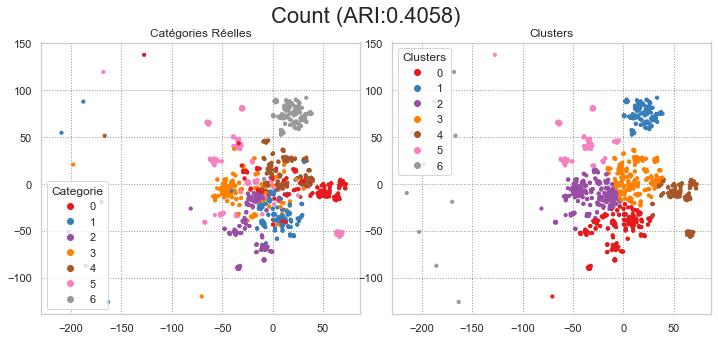

ARI: 0.4058 Time: 0.0


In [20]:
ARI, reduced, labels = ARI_fct(count_bow, categs)
TSNE_visu_fct(reduced, categs, labels, ARI, time_count, 'Count', Scores=Scores_text_bow)

#### 2.3.1.2. TF-IDF

In [21]:
# création du bag of words (Tf-idf)
time1 = time.time()
ctf = TfidfVectorizer(max_df=max_df, ngram_range=ngram, sublinear_tf=True)
tfidf_bow = ctf.fit_transform(df_corpus['description'])
time_tfidf = np.round(time.time() - time1,0)

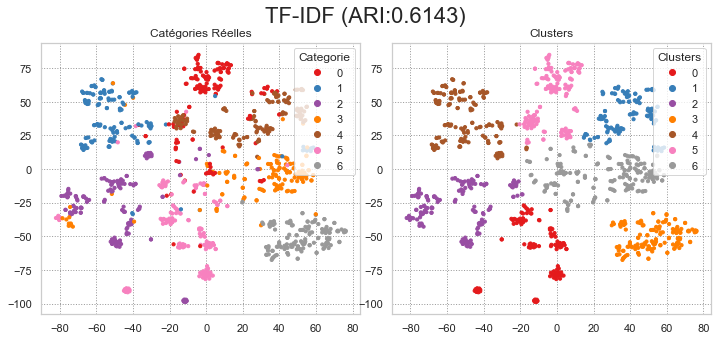

ARI: 0.6143 Time: 0.0


In [22]:
ARI, reduced, labels = ARI_fct(tfidf_bow, categs)
TSNE_visu_fct(reduced, categs, labels, ARI, time_tfidf, 'TF-IDF', Scores=Scores_text_bow)

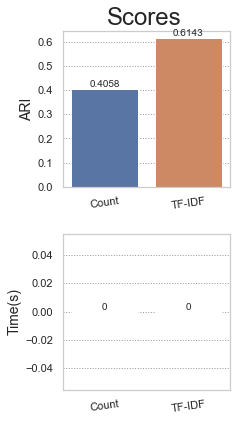

In [23]:
Scores_text = pd.concat([Scores_text, Scores_text_bow], ignore_index=True)
display_scores(Scores_text, yloc=0.93)

Le sac-de-mots TF-IDF donne une meilleure segmentation que le comptage simple, car TF-IDF permet de faire ressortir les particularités de chaque documents (description d’article), et par conséquent une meilleure représentation des documents.

### 2.3.2. Embeddings

<p>La deuxième de famille de techniques d’extraction de features textuelles va représenter chaque mot par un vecteur de taille donnée, appelé « embedding », avec une particularité :  plus des mots sont similaires en sens, plus ils auront des vecteurs avec des composantes (valeurs) similaires. </p>

<p>Enfin, les vecteurs de mots présents dans un documents (description d’article) sont combinés, selon la technique utilisée, pour donner un vecteur représentant l’idée général d’un document. Ces embeddings serviront au clustering des descriptions d’articles.</p>

<p>
    L’ensemble de ces techniques se basent sur des réseaux de neurones (plus ou moins profonds) entrainés sur de larges corpus de texte, comme Wikipédia.
    Heureusement, il n’est pas nécessaire de procéder à l’apprentissage de tels modèles. Plusieurs modèles « pré-entrainé » sont disponibles. Cette sous-section présente l’utilisation de certains de ces modèles, pour extraire les embeddings des description des articles, et la segmentation résultante.
</p>


In [24]:
embeddings = {}

def load_embeddings():
    global embeddings
    try:        
        with open("embeddings.pkl", "rb") as f:
            embeddings = pickle.load(f)
    except:
        pass

def save_embeddings(model, embeds):
    global embeddings
    load_embeddings()
    embeddings[model] = embeds
    with open("embeddings.pkl", "wb") as f:
        pickle.dump(embeddings, f)

In [25]:
best_params = pd.DataFrame(columns=['Model', 'max_length', 'size', 'ARI'], index=[])

def load_best_params():
    global best_params    
    best_params = pd.read_csv('best_params.csv', dtype={'max_length': 'int32', 'size': 'int32'}, low_memory=low_memory)

def save_best_params(model_name):
    global best_params     
    # Convertion de type
    best_params2 = best_params.copy()
    load_best_params()    
    if model_name not in best_params['Model'].values:
        i = len(best_params)
        best_params.loc[i, 'Model'] = model_type    
    best_params.loc[best_params['Model']==model_name, :] = best_params2[best_params2['Model']==model_name]
    best_params.to_csv('best_params.csv', index=False)

In [26]:
recompute = 0 # 0: display previously computed embeddings, 1: recompute embeddings with previously found best_params, 2: grid search of the best_params (resume from the given hyperparams), 3: grid search of the best_params (full search from the start)
 # Load previously computed embeddings
load_embeddings()
# Load previously computed best_params
load_best_params()

#### 2.3.2.1. Gensim

Chaque modèle GENSIM est exécuté plusieurs fois afin de trouver les meilleures valeurs des hyperparamètres : <em>max_length</em> (longueur maximale d’un document/description), <em>vector_size</em> (taille des vecteurs d’embedding).

In [27]:
Scores_text_gensim = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])
sentences = df_corpus['description'].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [28]:
def gensim_embd(sentences, model_type='Word2Vec', vector_size=250, max_length=30, window=5, min_count=1, epochs=100, verbose=True):
    # Création et entraînement du modèle FastText
    if verbose:
        print("Build & train "+model_type+" model ...")
    
    time1 = time.time()
    model = None
    if model_type == 'Word2Vec':
        model = gensim.models.Word2Vec(min_count=min_count, window=window, vector_size=vector_size, seed=0, workers=cpu_count())
    if model_type == 'FastText':
        model = gensim.models.FastText(min_count=min_count, window=window, vector_size=vector_size, seed=0, workers=cpu_count())
    
    model.build_vocab(sentences)
    model.train(sentences, total_examples=model.corpus_count, epochs=epochs)
    model_vectors = model.wv
    words = model_vectors.index_to_key
    if verbose:
        print("Vocabulary size: %i" % len(words))
        print(model_type+" trained")


    # Préparation des sentences (tokenization)
        print("Fit Tokenizer ...")
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(sentences)
    x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                        maxlen=max_length,
                                                        padding='post') 
                                                    
    num_words = len(tokenizer.word_index) + 1
    if verbose:
        print("Number of unique words: %i" % num_words)

    # Création de la matrice d'embedding
        print("Create Embedding matrix ...")
    word_index = tokenizer.word_index
    vocab_size = len(word_index) + 1
    embedding_matrix = np.zeros((vocab_size, vector_size))
    i=0
    j=0
        
    for word, idx in word_index.items():
        i +=1
        if word in words:
            j +=1
            embedding_vector = model_vectors[word]
            if embedding_vector is not None:
                embedding_matrix[idx] = model_vectors[word]
                
    word_rate = np.round(j/i,4)
    if verbose:
        print("Word embedding rate : ", word_rate)
        print("Embedding matrix: %s" % str(embedding_matrix.shape))


    # Création du modèle
    word_input=Input(shape=(max_length,),dtype='float64')  
    word_embedding=Embedding(input_dim=vocab_size,
                            output_dim=vector_size,
                            weights = [embedding_matrix],
                            input_length=max_length)(word_input)
    word_vec=GlobalAveragePooling1D()(word_embedding)  
    embed_model = Model([word_input],word_vec)

    if verbose:
        embed_model.summary()    

    features = embed_model.predict(x_sentences, workers=cpu_count(), use_multiprocessing=True)
    _time = np.round(time.time() - time1,0)

    ARI, reduced, labels = ARI_fct(features, categs) 
    return ARI, reduced, labels, _time, features

def gensim_embd_grid(Scores, sentences, model_type='Word2Vec', vector_size_min=200, window=5, min_count=1, epochs=100, recompute=3, verbose=False):
    best_ARI = best_params.loc[best_params['Model']==model_type, 'ARI'].tolist()[0] if model_type in best_params['Model'].tolist() and recompute==2 else 0
    best_vector_size = best_params.loc[best_params['Model']==model_type, 'size'].tolist()[0] if model_type in best_params['Model'].tolist() and recompute==2 else 0
    best_max_length = best_params.loc[best_params['Model']==model_type, 'max_length'].tolist()[0] if model_type in best_params['Model'].tolist() and recompute==2 else 0
    best_reduced = None
    best_labels = None
    best_time = None

    for vector_size in np.arange(vector_size_min,700+1, 20):
        for max_length in np.arange(20,80+1, 5):
            print('==================== vector_size=', vector_size, ' max_length=', max_length, '====================')
            ARI, reduced, labels, _time, features = gensim_embd(sentences, model_type, vector_size, max_length, window, min_count, epochs, verbose)
            print('ARI:', ARI, 'Time:', _time)

            if ARI > best_ARI:
                best_ARI = ARI
                best_vector_size = vector_size
                best_max_length = max_length
                best_reduced = reduced
                best_labels = labels
                best_time = _time                
                save_embeddings(model_type, features)
                      
                # Save Best Params
                if model_type not in best_params['Model'].values:
                    i = len(best_params)
                    best_params.loc[i, 'Model'] = model_type
                best_params.loc[best_params['Model']==model_type, 'ARI'] = best_ARI
                best_params.loc[best_params['Model']==model_type, 'size'] = best_vector_size
                best_params.loc[best_params['Model']==model_type, 'max_length'] = best_max_length
                best_params.loc[best_params['Model']==model_type, 'time'] = best_time
                save_best_params(model_type)

    # Display Best Params
    print('best_ARI=', best_ARI, 'best_vector_size=', best_vector_size, 'best_max_length=', best_max_length)
    best_ARI, best_reduced, best_labels = ARI_fct(embeddings[model_type], categs)
    TSNE_visu_fct(best_reduced, categs, best_labels, best_ARI, best_time, model_type+'('+str(vector_size)+','+str(max_length)+')', Scores)   

def gensim_run(model_type, recompute=0, verbose=False, vector_size_min=200, Scores=None):
    c1= model_type in embeddings
    c2 = model_type in best_params['Model'].values

    vector_size = None
    max_length = None
    if c2:
        vector_size = best_params.loc[best_params['Model']==model_type, 'size'].tolist()[0]
        max_length = best_params.loc[best_params['Model']==model_type, 'max_length'].tolist()[0]                    
    
    if c1 and recompute==0:
        _time = best_params.loc[best_params['Model']==model_type, 'time'].tolist()[0]
        ARI, reduced, labels = ARI_fct(embeddings[model_type], categs)
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_type+'('+str(vector_size)+','+str(max_length)+')', Scores)
    
    if recompute==1 or (not c1 and c2):
        best_ARI = round(best_params.loc[best_params['Model']==model_type, 'ARI'].tolist()[0], 3)
        ARI = 0
        reduced = labels = _time = features = None        

        while ARI < best_ARI:            
            ARI, reduced, labels, _time, features = gensim_embd(sentences=sentences, model_type=model_type, vector_size=vector_size, max_length=max_length, verbose=verbose)
            print('current_ARI:', ARI, 'best_ARI:', best_ARI, 'time:', _time)
        
        clear_output(wait=True)
        save_embeddings(model_type, features)
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_type+'('+str(vector_size)+','+str(max_length)+')', Scores)
        
        best_params.loc[best_params['Model']==model_type, 'ARI'] = ARI
        best_params.loc[best_params['Model']==model_type, 'time'] = _time
        save_best_params(model_type)
    
    if recompute==3:
        vector_size_min = 200
    if recompute>=2 or (not c1 and not c2):
        gensim_embd_grid(Scores=Scores, sentences=sentences, model_type=model_type, vector_size_min=vector_size_min, recompute=recompute, verbose=verbose)

##### 2.3.2.1.1. Word2Vec

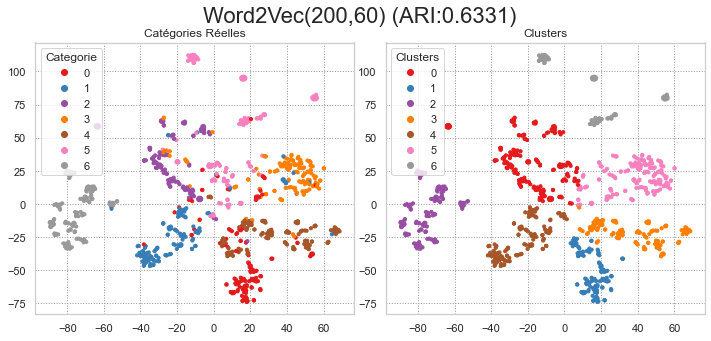

ARI: 0.6331 Time: 6


In [29]:
gensim_run('Word2Vec', recompute=recompute, Scores=Scores_text_gensim)

##### 2.3.2.1.2. FastText

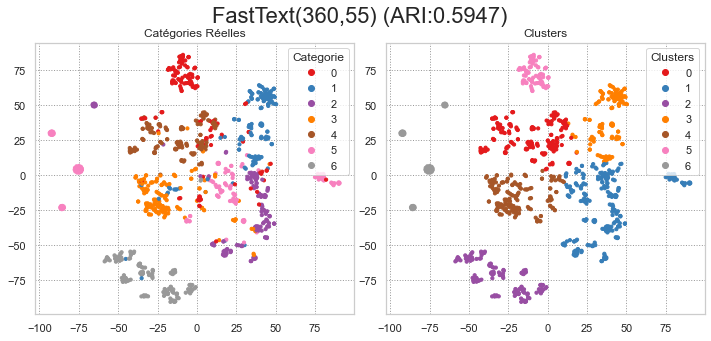

ARI: 0.5947 Time: 36


In [30]:
gensim_run('FastText', recompute=recompute, Scores=Scores_text_gensim, vector_size_min=580)

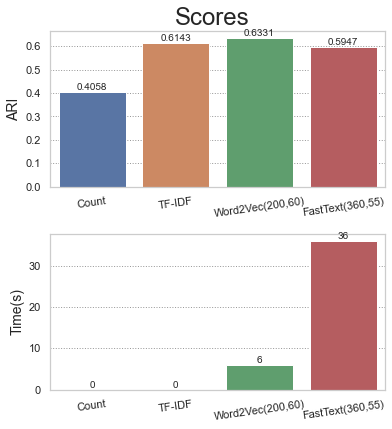

In [31]:
Scores_text = pd.concat([Scores_text, Scores_text_gensim], ignore_index=True)
display_scores(Scores_text, yloc=0.93)

<p>Les modèles GENSIM, « Word2Vec » en particuliers, présentent une meilleure segmentation  que les sac-de-mots.</p>
<p><strong>À noter !</strong> Les meilleures valeurs des hyperparamètres <em>(vector_size, max_length)</em> sont indiqués juste après le nom de chaque modèle GENSIM.</p>

#### 2.3.2.2. BERT

<p>Les modèles BERT (Bidirectional Encoder Representations from Transformers) sont des modèles pré-entrainés (sur Wikipédia et BookCorpus) dont les hyperparamètres, notamment la taille des embeddings, sont optimisés. En revanche,  les hyperparamètres <em>max_length</em> et <em>bacth_size</em> seront optimisés sur notre dataset.</p>

In [32]:
my_tokenizers = {}

def load_my_tokenizers():    
    global my_tokenizers
    try:
        with open("my_tokenizers.pkl", "rb") as f:
            my_tokenizers = pickle.load(f)
    except:
        pass

def save_my_tokenizers(model_name, tokenizer):
    global my_tokenizers
    load_my_tokenizers()
    my_tokenizers[model_name] = tokenizer
    with open("my_tokenizers.pkl", "wb") as f:
        pickle.dump(my_tokenizers, f)

my_text_models = {'HuggingFace':{}, 'TensorFlow_Hub':{}}

def load_my_text_models():    
    global my_text_models
    path = "C:/my_models/Text/"
    
    for mode in ['HuggingFace', 'TensorFlow_Hub']:
        my_text_models[mode]={}
        for (dirpath, dirnames, filenames) in os.walk(path+mode+'/'):
            if dirpath == path+mode+'/':
                for model_name in dirnames:
                    if mode == 'HuggingFace':
                        my_text_models[mode][model_name] = load_model(path+mode+'/'+model_name)
                    if mode == 'TensorFlow_Hub':
                        my_text_models[mode][model_name] = hub.KerasLayer(path+mode+'/'+model_name, trainable=True)

def save_my_text_models(model_name, model, mode):
    global my_text_models
    load_my_text_models()
    my_text_models[mode][model_name] = model
    
    path = "C:/my_models/Text/"
    if mode == 'HuggingFace':
        model.save(path+mode+"/"+model_name)

In [33]:
# Fonction de préparation des sentences
def inp_fct(model_type, sentences, tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    inp_tot = []

    for sent in sentences:
        inp = tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length' if 'gpt' not in model_type else False,
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(inp['input_ids'][0])
        token_type_ids.append(inp['token_type_ids'][0])
        attention_mask.append(inp['attention_mask'][0])
        inp_tot.append((inp['input_ids'][0], 
                             inp['token_type_ids'][0], 
                             inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, inp_tot
    

# Fonction de création des features
def feature_fct(model, model_type, sentences, max_length, b_size, mode='HuggingFace'):
    model_name = model_type + '_' + mode
    batch_size = b_size
    batch_size_pred = b_size
    tokenizer = None
    if model_name not in my_tokenizers:
        save_my_tokenizers(model_name, AutoTokenizer.from_pretrained(model_type))
    tokenizer = my_tokenizers[model_name]

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, inp_tot = inp_fct(model_type, sentences[idx:idx+batch_size], 
                                                                      tokenizer, max_length)
        
        if mode=='HuggingFace' :    #  HuggingFace
            if 'distilbert' in model_type:
                outputs = model.predict([input_ids, attention_mask], batch_size=batch_size_pred)
            else:
                outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TensorFlow_Hub' : # Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 }
            if 'distilbert' not in model_type:
                text_preprocessed["input_type_ids"] = token_type_ids
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features = np.array(last_hidden_states_tot).mean(axis=1)
     
    return features, last_hidden_states_tot

In [34]:
def compare(sentences, model_type, mode, max_length=64, batch_size=10, display=True, model_url=None, Scores=None):
    model_name =  model_type + '_'+mode
    time1 = time.time()
    model = None
    
    if model_name not in my_text_models[mode]:
        if mode=='HuggingFace': #Hugging Face
            save_my_text_models(model_name, TFAutoModel.from_pretrained(model_type), mode)        
        if mode=='TensorFlow_Hub' : # Tensorflow Hub            
            save_my_text_models(model_name, hub.KerasLayer(model_url, trainable=True), mode)
    model = my_text_models[mode][model_name]   
    features, last_hidden_states_tot = feature_fct(model, model_type, sentences, max_length, batch_size, mode=mode)

    _time = np.round(time.time() - time1,0)

    ARI, reduced, labels = ARI_fct(features, categs)
    if display:
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_name+'('+str(batch_size)+','+str(max_length)+')', Scores)        
        return features
    else:
        return ARI, reduced, labels, _time, features

def compare_grid(Scores, sentences, model_type, mode, model_url=None, recompute=3, max_length_min=20):
    model_name =  model_type + '_'+mode
    best_ARI = best_params.loc[best_params['Model']==model_name, 'ARI'].tolist()[0] if model_name in best_params['Model'].tolist() and recompute==2 else 0
    best_max_length = best_params.loc[best_params['Model']==model_name, 'max_length'].tolist()[0] if model_name in best_params['Model'].tolist() and recompute==2 else 0
    best_batch_size = best_params.loc[best_params['Model']==model_name, 'size'].tolist()[0] if model_name in best_params['Model'].tolist() and recompute==2 else 0    
    best_reduced = None
    best_labels = None
    best_time = None

    for max_length in range(max_length_min, 70+1, 5):
        for batch_size in range(5,30+1, 5):
            print('========================== max_length =', max_length, 'batch_size =', batch_size, '==========================')
            ARI, reduced, labels, _time, features = compare(sentences, model_type, mode, max_length, batch_size, display=False, model_url=model_url)          
            print('ARI:', ARI, 'best_ARI:', best_ARI, 'Time:', _time)  

            if ARI > best_ARI:
                best_ARI = ARI
                best_max_length = max_length
                best_batch_size = batch_size
                best_reduced  = reduced
                best_labels = labels
                best_time = _time
                save_embeddings(model_name, features)

                # Save Best Params
                if model_name not in best_params['Model'].values:
                    i = len(best_params)
                    best_params.loc[i, 'Model'] = model_name
                best_params.loc[best_params['Model']==model_name, 'ARI'] = best_ARI
                best_params.loc[best_params['Model']==model_name, 'size'] = best_batch_size
                best_params.loc[best_params['Model']==model_name, 'max_length'] = best_max_length
                best_params.loc[best_params['Model']==model_name, 'time'] = best_time
                save_best_params(model_name)
    # Display Best Params    
    print('best_ARI=', best_ARI, 'best_batch_size=', best_batch_size, 'best_max_length=', best_max_length)
    best_ARI, best_reduced, best_labels = ARI_fct(embeddings[model_name], categs)
    TSNE_visu_fct(best_reduced, categs, best_labels, best_ARI, best_time, model_name+'('+str(batch_size)+','+str(max_length)+')', Scores)

def BERT(model_type, mode, model_url=None, recompute=0, max_length_min=20, Scores=None):        
    model_name =  model_type.split('-')[0] + '_'+mode

    c1 = model_name in embeddings
    c2 = model_name in best_params['Model'].values

    batch_size = None
    max_length = None
    if c2:
        batch_size=best_params.loc[best_params['Model']==model_name, 'size'].tolist()[0]
        max_length=best_params.loc[best_params['Model']==model_name, 'max_length'].tolist()[0]                
    
    if c1 and recompute==0:
        _time = best_params.loc[best_params['Model']==model_name, 'time'].tolist()[0]
        ARI, reduced, labels = ARI_fct(embeddings[model_name], categs)
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_name+'('+str(batch_size)+','+str(max_length)+')', Scores, mode)

    if recompute==1 or (not c1 and c2):
        best_ARI = round(best_params.loc[best_params['Model']==model_name, 'ARI'].tolist()[0], 3)
        ARI = 0
        reduced = labels = _time = features = None        

        while ARI < best_ARI:            
            ARI, reduced, labels, _time, features = compare(Scores=Scores, sentences=sentences, model_type=model_type, mode=mode, model_url=model_url, batch_size=batch_size, max_length=max_length, display=False)
            print('current_ARI:', ARI, 'best_ARI:', best_ARI, 'time:', _time)
        
        clear_output(wait=True)
        save_embeddings(model_name, features)
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_name+'('+str(batch_size)+','+str(max_length)+')', Scores, mode)
        
        best_params.loc[best_params['Model']==model_name, 'ARI'] = ARI
        best_params.loc[best_params['Model']==model_name, 'time'] = _time
        save_best_params(model_name)

    if recompute>=2 or (not c1 and not c2):
        compare_grid(Scores=Scores, sentences=sentences, model_type=model_type, mode=mode, model_url=model_url, recompute=recompute, max_length_min=max_length_min)

In [35]:
Scores_text_bert = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])
# Load previously downloaded models
load_my_text_models()
# Load previously downloaded tokenizers
load_my_tokenizers()

##### 2.3.2.2.1. HuggingFace

In [36]:
recompute = 0 # 0: display previously computed embeddings, 1: recompute embeddings with previously found best_params, 2: grid search of the best_params (resume from the given hyperparams), 3: grid search of the best_params (full search from the start)
sentences = df_corpus['description'].to_list()

###### 2.3.2.2.1.1 Bert

Le premier modèle BERT (version de base).

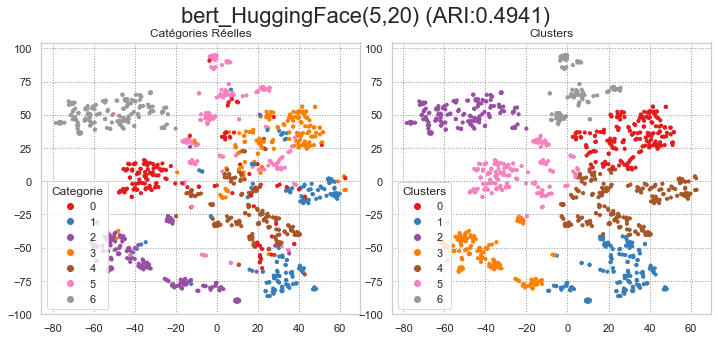

ARI: 0.4941 Time: 86


In [37]:
BERT('bert-base-uncased', 'HuggingFace', recompute=recompute, Scores=Scores_text_bert)

###### 2.3.2.2.1.2. RoBerta

RoBERTa (A Robustly Optimized BERT Pretraining Approach), s’appuie sur BERT avec différentes valeurs d’hyperparamètres et un taux/vitesse d’apprentissage réduite afin d’obtenir des meilleurs résultats. 

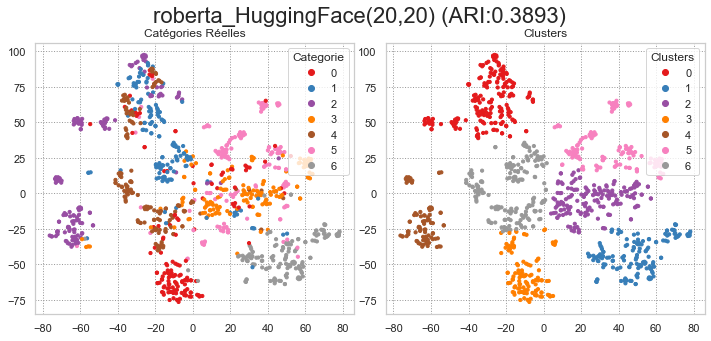

ARI: 0.3893 Time: 30


In [38]:
BERT('roberta-base', 'HuggingFace', recompute=recompute, Scores=Scores_text_bert)

###### 2.3.2.2.1.3. DistilBert

DistilBERT (distilled BERT) est une version distillée de BERT : plus petit, plus rapide, moins couteux et plus léger. Il a 40% moins de paramètres (poids à apprendre), 60% plus rapide tout en préservant plus de 95% des performances de BERT. 

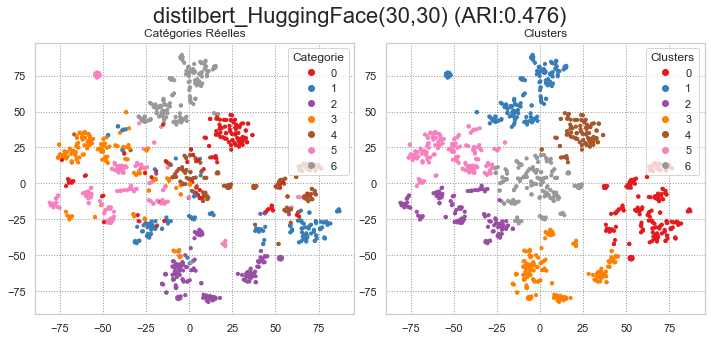

ARI: 0.476 Time: 23


In [39]:
BERT('distilbert-base-uncased', 'HuggingFace', recompute=recompute, Scores=Scores_text_bert)

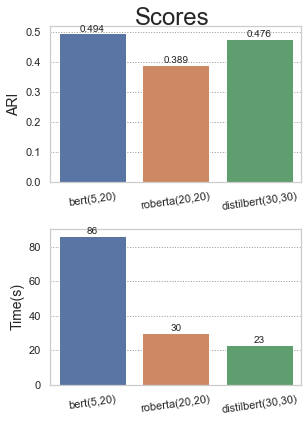

In [40]:
display_scores(Scores_text_bert)

Le modèle « distilbert », comme introduit précédemment, donne des résultats quasiment équivalents au modèle « bert » de base mais avec un temps d’exécution beaucoup plus faible. Ce qui représente le meilleur compromis dans la famille BERT.

##### 2.3.2.2.2. TensorFlow Hub

Les modèles BERT sont à nouveau tester avec une implémentation différente (TensorFlow) permettant d’exploiter la puissance d’un GPU pour de meilleures performances.

In [41]:
recompute = 0 # 0: display previously computed embeddings, 1: recompute embeddings with previously found best_params, 2: grid search of the best_params (resume from the given hyperparams), 3: grid search of the best_params (full search from the start)
sentences = df_corpus['description'].to_list()

###### 2.3.2.2.2.1. Bert

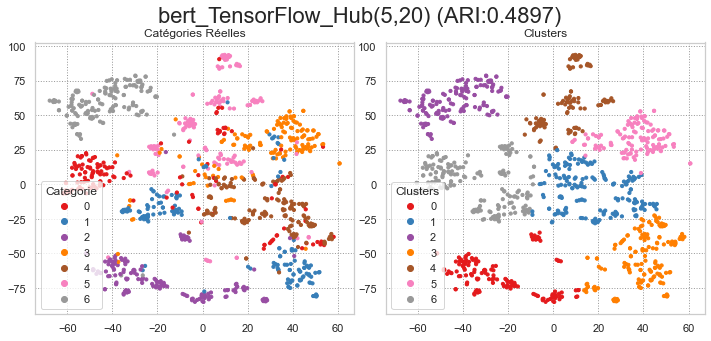

ARI: 0.4897 Time: 19


In [42]:
model_type='bert-base-uncased'
model_url='https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
BERT(model_type, 'TensorFlow_Hub', model_url, recompute=recompute, Scores=Scores_text_bert)

###### 2.3.2.2.2.2. RoBerta

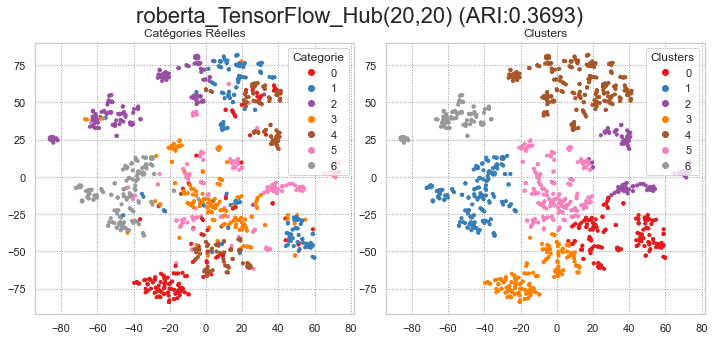

ARI: 0.3693 Time: 8


In [43]:
model_type='roberta-base'
model_url='https://tfhub.dev/jeongukjae/roberta_en_cased_L-12_H-768_A-12/1'
BERT(model_type, 'TensorFlow_Hub', model_url, recompute=recompute, Scores=Scores_text_bert)

###### 2.3.2.2.2.3. DistilBert

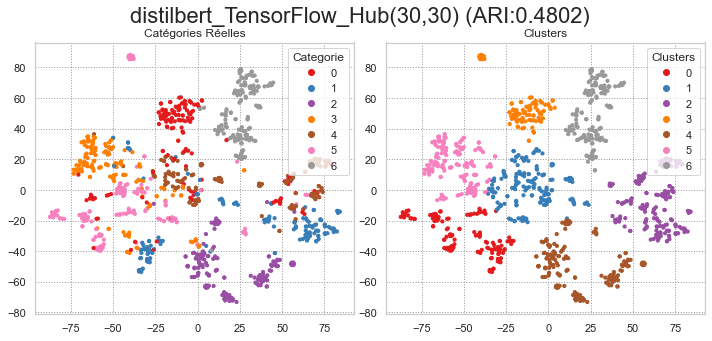

ARI: 0.4802 Time: 7


In [44]:
model_type='distilbert-base-uncased'
model_url='https://tfhub.dev/jeongukjae/distilbert_en_uncased_L-6_H-768_A-12/1'
BERT(model_type, 'TensorFlow_Hub', model_url, recompute=recompute, Scores=Scores_text_bert)

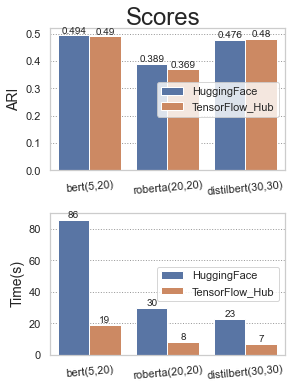

In [45]:
display_scores(Scores_text_bert, yloc=0.93, hue='Implementation')

Les modèles BERT de TensorFlow donne des résultats équivalents aux modèles HuggingFace, avec un gain en temps très important grâce à la puissance du GPU. Par conséquent, on ne garde que les modèles plus efficients de TensorFlow.

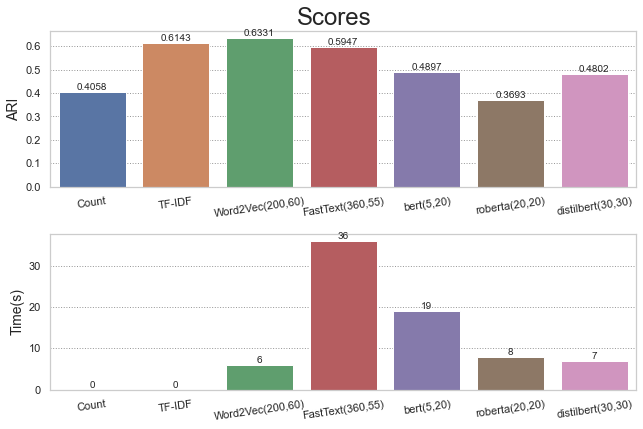

In [46]:
Scores_text = pd.concat([Scores_text, Scores_text_bert[Scores_text_bert['hue']=='TensorFlow_Hub']], ignore_index=True)
display_scores(Scores_text, yloc=0.93)

Les prochains modèles d’embeddings sont des modèles propriétaires mis à disposition aux utilisateurs gratuitement ou avec un quota limité.

#### 2.3.2.3. USE (Universal Sentence Encoder) - GoogleAI

In [47]:
sentences = df_corpus['description'].to_list()

In [48]:
def USE_embd(sentences, model_type='USE', batch_size=10, display=True, Scores=None):    
    mode = 'TensorFlow_Hub'
    if len(sentences)>0:        
        if model_type not in my_text_models:
            save_my_text_models(model_type, hub.load("https://tfhub.dev/google/universal-sentence-encoder/4"), mode)
        model = my_text_models[mode][model_type]  

        time1 = time.time()

        for step in range(len(sentences)//batch_size) :
            idx = step*batch_size
            feat = model(sentences[idx:idx+batch_size])

            if step ==0 :
                features = feat
            else :
                features = np.concatenate((features,feat))

        _time = np.round(time.time() - time1,0)
        save_embeddings(model_type, features)
    
    ARI, reduced, labels = ARI_fct(features, categs)

    if display:        
        TSNE_visu_fct(reduced, categs, labels, ARI, _time, model_type, Scores)
    else:
        return ARI, reduced, labels, _time, features

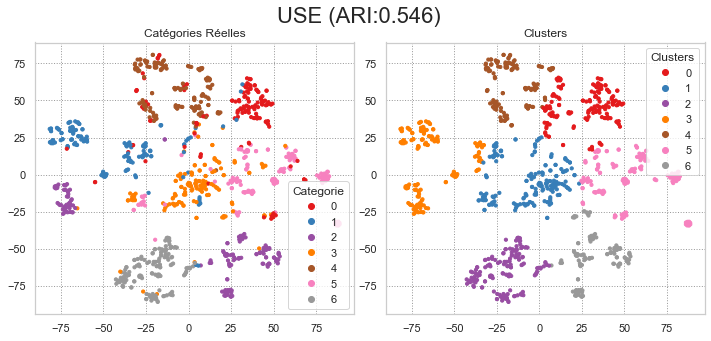

ARI: 0.546 Time: 2.0


In [49]:
with tf.device('/CPU:0'): #Empêcher le modèle d'utiliser le GPU (bug sur le GPU)
    USE_embd(sentences, 'USE', Scores=Scores_text)

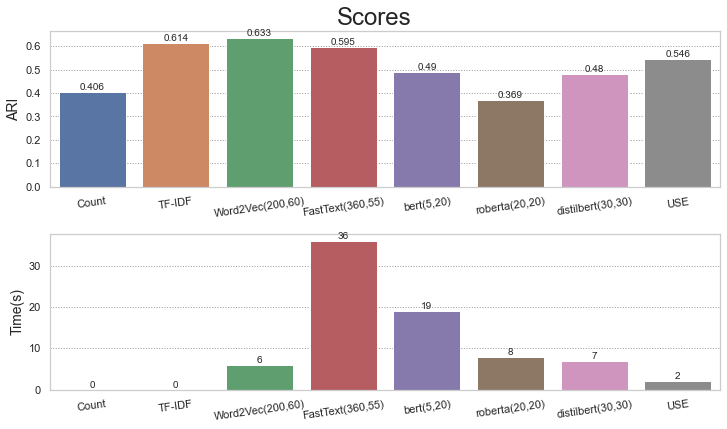

In [50]:
display_scores(Scores_text, yloc=0.93)

Le modèle USE, bien que plus performant que les modèle BERT, est moins que les modèles GENSIM.

#### 2.3.2.4. GPT3 - OpenAI

<p>Les modèles GPT3 sont propriété d’OpenAI, qui met à disposition ses modèles de façon limité (sur le nombre de token), grâce à une API qui prend en charge tout le traitement de texte en ligne jusqu’à obtenir les embeddings</p>

In [51]:
Scores_text_gpt3 = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])
sentences = df_corpus['description'].to_list()

In [52]:
def openai_gpt3(model="text-similarity-curie-001", name='GPT3', text=[], recompute=False, concat=False, display=True):
    global Scores_text
    # Fet the Embeddings with the API
    if (name not in embeddings or recompute) and len(text)>0:
        # Load the private/personal OpenAi API KEY
        with open("openai_key.txt", "r") as f:
            openai.api_key = f.read()
        gpt3 = np.array([get_embedding(txt, engine=model) for txt in text])
        if concat and name in embeddings:
            embeddings[name] = np.concatenate((embeddings[name],gpt3))
        else:
            embeddings[name] = gpt3
        save_embeddings(name, embeddings[name])
    
    if display:
        ARI, reduced, labels = ARI_fct(embeddings[name], categs)
        TSNE_visu_fct(reduced, categs, labels, ARI, None, name, Scores=Scores_text_gpt3)

##### 2.3.2.4.1. Davinci

Le modèle le plus complet et le plus puissant est nommé « Davinci ». Au vu, de la taille du data set et de la limite d’OpenAi, seulement 80% du data set peut être traité par ce modèle.

In [53]:
name='GPT3-davinci'
if name not in embeddings:
    batch = 20
    wait_time = 70    

    for i in range(batch):
        print('Batch :', i+1,'/', batch, '...')
        openai_gpt3(model='text-similarity-davinci-001', name=name, text=sentences[i*len(sentences)//batch:(i+1)*len(sentences)//batch], recompute=True, concat=True, display=i==(batch-1))
        if i<batch-1:
            print("Pause one minute to avoid the 1 minute RateLimit...")
            time.sleep(wait_time)

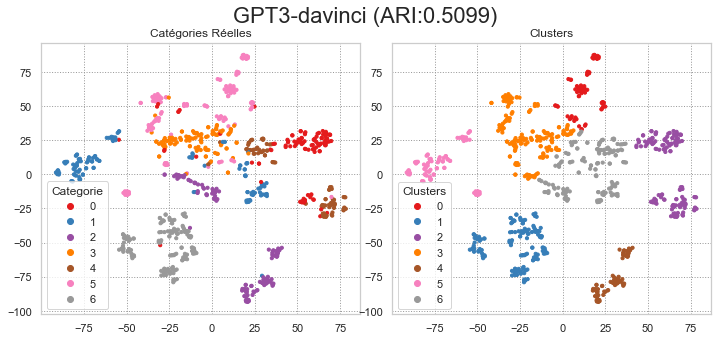

ARI: 0.5099 Time: None


In [54]:
openai_gpt3(name='GPT3-davinci')

##### 2.3.2.4.2. Curie

Le modèle « Curie » est une version plus légère de « Davinci » avec des performances quasi équivalentes. On peut donc obtenir de bons résultats tout en traitant la totalité du data set.

In [55]:
name='GPT3-curie'
if name not in embeddings:
    batch = 20
    wait_time = 70

    for i in range(batch):
        print('Batch :', i+1,'/', batch, '...')
        openai_gpt3(model='text-similarity-curie-001', name='GPT3-curie', text=sentences[i*len(sentences)//batch:(i+1)*len(sentences)//batch], recompute=True, concat=True, display=i==(batch-1))
        if i<batch-1:
            print("Pause one minute to avoid the 1 minute RateLimit...")
            time.sleep(wait_time)

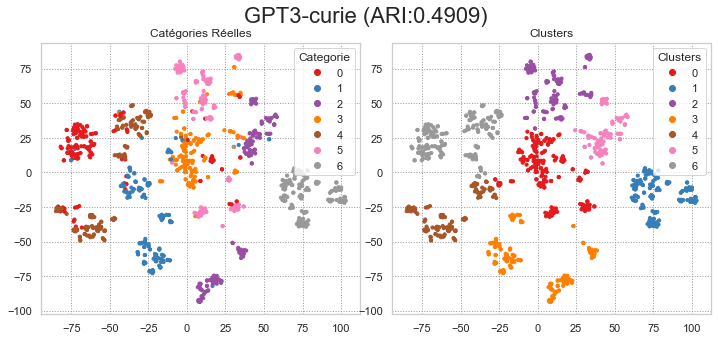

ARI: 0.4909 Time: None


In [56]:
openai_gpt3(name='GPT3-curie')

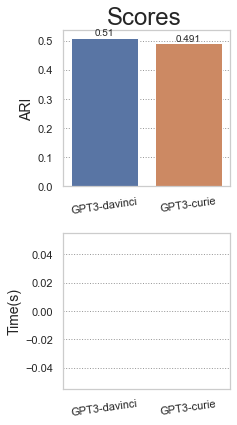

In [57]:
display_scores(Scores_text_gpt3, yloc=0.93)

Comme annoncé par OpenAI, le mdoèle GPT3-Curie, bien que plus légers, donne des résultats aussi bons que ceux du modèle GPT3-Davinci (modèle le complet) sur notre data set.

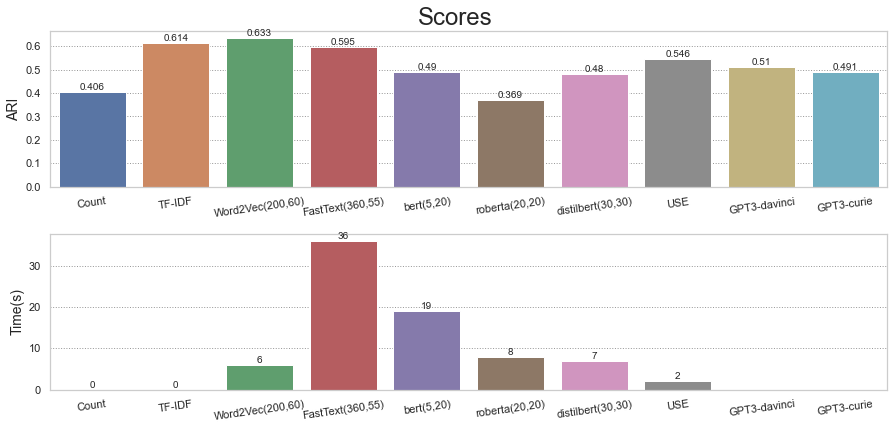

In [58]:
Scores_text = pd.concat([Scores_text, Scores_text_gpt3], ignore_index=True)
display_scores(Scores_text, yloc=0.93)

<p>Les modèles GPT3 par rapport aux autres modèles, à l’exception des modèles BERT, sont moins efficaces sur notre data set.</p>
<p>En conclusion, sur notre data set, le modèle Word2Vec présente le meilleur compromis entre la qualité des embeddings et le temps nécessaire à les extraire, car il est basé sur un réseau de neurones peu profond mais capable de mieux capturer les similarités sémantiques des mots des description textuelles de nos articles.</p>

# 3. Segmentation basée Images

La segmentation des articles sur la base des images est similaire à la segmentation textuelle. Elle ce base sur des features (points/régions d’image) pertinentes décrites par des vecteurs (analogues des embeddings de texte). Ces features sont extraites par des méthodes exactes ou des Réseaux de Neurones Convolutifs (CNN) pré-entrainés sur un large data set d’images variées (1 000 catégories), nommé « ImageNet ».

## 3.1. Chargement des Images

In [59]:
models_path = "C:/my_models/Image/"
images_path = "./Flipkart/Images/"

In [60]:
df_images = df_corpus[['categ_str', 'categ']]
df_images['image'] = df['image']
df_images

C:\Users\Shadow\AppData\Local\Temp/ipykernel_25568/1174052021.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_images['image'] = df['image']


,categ_str,categ,image
0,Home Furnishing,4,55b85ea15a1536d46b7190ad6fff8ce7.jpg
1,Baby Care,0,7b72c92c2f6c40268628ec5f14c6d590.jpg
2,Baby Care,0,64d5d4a258243731dc7bbb1eef49ad74.jpg
3,Home Furnishing,4,d4684dcdc759dd9cdf41504698d737d8.jpg
4,Home Furnishing,4,6325b6870c54cd47be6ebfbffa620ec7.jpg
...,...,...,...
1045,Baby Care,0,958f54f4c46b53c8a0a9b8167d9140bc.jpg
1046,Baby Care,0,fd6cbcc22efb6b761bd564c28928483c.jpg
1047,Baby Care,0,5912e037d12774bb73a2048f35a00009.jpg
1048,Baby Care,0,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg


## 3.2. Preprocess Images

In [61]:
def imagePreProcessing(image_name):
    img = load_img(images_path+image_name, target_size=(224, 224))  # Charger l'image
    img = img_to_array(img)  # Convertir en tableau numpy
    img = preprocess_input(img)  # Prétraiter l'image comme le veut le CNN    
    return img

In [62]:
df_images =  df_images[['image', 'categ']]
df_images['image'] = df_images['image'].apply(imagePreProcessing)
df_images

C:\Users\Shadow\AppData\Local\Temp/ipykernel_25568/669996255.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_images['image'] = df_images['image'].apply(imagePreProcessing)


,image,categ
0,"[[[90.061, 86.221, 82.32], [87.061, 86.221, 81...",4
1,"[[[151.061, 138.22101, 131.32], [151.061, 138....",0
2,"[[[151.061, 138.22101, 131.32], [151.061, 138....",0
3,"[[[151.061, 138.22101, 131.32], [151.061, 138....",4
4,"[[[-95.939, -99.779, -103.68], [15.060997, 7.2...",4
...,...,...
1045,"[[[149.061, 138.22101, 131.32], [150.061, 137....",0
1046,"[[[120.061, 99.221, 129.32], [120.061, 99.221,...",0
1047,"[[[151.061, 138.22101, 131.32], [151.061, 138....",0
1048,"[[[-49.939003, -64.779, -71.68], [-44.939003, ...",0


In [63]:
n_classes = len(set(categs))

In [64]:
def reshapeImageSet(img_set):
    img_set2 = img_set.values[0,0]

    for i in range (1, len(img_set)):
        img_set2 = np.concatenate((img_set2, img_set.values[i,0]))

    return img_set2.reshape((len(img_set), img_set2.shape[1], img_set2.shape[1], img_set2.shape[2]))

In [65]:
images = reshapeImageSet(pd.DataFrame(df_images['image']))
Y = categs

## 3.3. Segmentation

De façon analogue à la segmentation textuelle, la segmentation par images se fait par des méthodes classiques (exactes) et par des réseaux de neurones (convolutifs) profonds pré-entrainés.

In [66]:
Scores_image = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])
my_image_models = {'Pre-trained':{}, 'Trained':{}}

In [67]:
my_features = {}

def load_features():
    global my_features
    try:        
        with open("features.pkl", "rb") as f:
            my_features = pickle.load(f)
    except:
        pass

def save_features(model, features):
    global my_features
    load_features()
    my_features[model] = features
    with open("features.pkl", "wb") as f:
        pickle.dump(my_features, f)

In [68]:
def evaluate_features(model_name, mode, features, categs, Scores=None, time=None):    
    ARI, reduced, labels = ARI_fct(features, categs)

    TSNE_visu_fct(reduced, categs, labels, ARI, time, model_name, Scores, mode)   

    save_features(model_name, features) 

### 3.3.1. Classic

Les méthodes classiques (exactes) se basent sur le gradient d’intensité des pixels et des filtres (Gaussiens notamment).

#### 3.3.1.1. SIFT

In [69]:
def SIFT(img_path):
    # reading the image
    img = cv2.imread(img_path)
    # convert to greyscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # create SIFT feature extractor
    sift = cv2.xfeatures2d.SIFT_create()
    # detect features from the image
    keypoints, descriptors = sift.detectAndCompute(img, None)

    return keypoints, descriptors

In [70]:
keypoints, descriptors = SIFT(images_path+df['image'][0])
descriptors.shape

(93040, 128)

In [71]:
keypoints, descriptors = SIFT(images_path+df['image'][2])
descriptors.shape

(7702, 128)

SIFT retourne des vecteurs de tailles variées, ce qui rend leur segmentation (par KMeans) impossible sans pré-traitements supplémentaires.

#### 3.3.1.2. ORB

ORB es une méthode plus efficiente que SIFT avec l’avantage de donner des features (vecteurs) de taille identiques.

In [72]:
def ORB(img_path):
    # reading the image
    img = cv2.imread(img_path)
    # convert to greyscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # create ORB feature extractor
    orb = cv2.ORB_create()
    # detect features from the image
    keypoints, descriptors = orb.detectAndCompute(img, None)

    return keypoints, descriptors

In [73]:
keypoints, descriptors = ORB(images_path+df['image'][0])
descriptors.shape

(500, 32)

In [74]:
keypoints, descriptors = ORB(images_path+df['image'][2])
descriptors.shape

(500, 32)

Tous les descripteurs (features) d’images sont aplatis et transformer en DataFrame représentant sous forme numérique toutes les images des articles.

In [75]:
all_descriptors = []
for i in range(len(df)):
    keypoints, descriptors = ORB(images_path+df['image'][i])
    try:
        descriptors = descriptors.flatten()
    except:
        descriptors = np.full([16000], np.nan)
    all_descriptors.append(descriptors)    

On transforme l’ensembles des features dans un format exploitable pour le clustering.

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

Le data set contient :
	- 1050 lignes et 16000 colonnes.
	- 675968 valeurs manquantes, ce qui représente 4.02 % du data set.


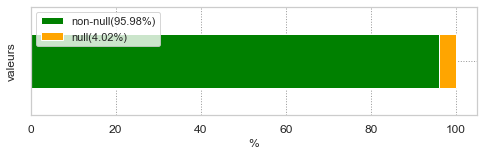

In [76]:
orbs = pd.DataFrame(all_descriptors).iloc[:,:16000]
display(orbs)
verifier_taille(orbs)

In [77]:
doublons(orbs)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [78]:
orbs = orbs.drop_duplicates()
display(doublons(orbs))
orbs.shape

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

(1034, 16000)

In [79]:
nans = valeurs_manquantes(orbs)
nans

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [80]:
orbs = orbs.drop(nans.index)

In [81]:
orbs = orbs.join(df_images['categ'])
orbs

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [82]:
categs = orbs.iloc[:,-1].values

In [83]:
features = orbs.iloc[:,:-1].values
features

array([[ 65., 120., 149., ..., 132., 236., 125.],
       [230., 185., 236., ..., 154., 116., 249.],
       [ 44.,  32., 224., ..., 241., 242., 224.],
       ...,
       [180.,  67., 109., ..., 132., 241.,  85.],
       [ 51., 201., 106., ..., 202., 240., 168.],
       [ 41.,  37., 121., ..., 245.,  48., 120.]])

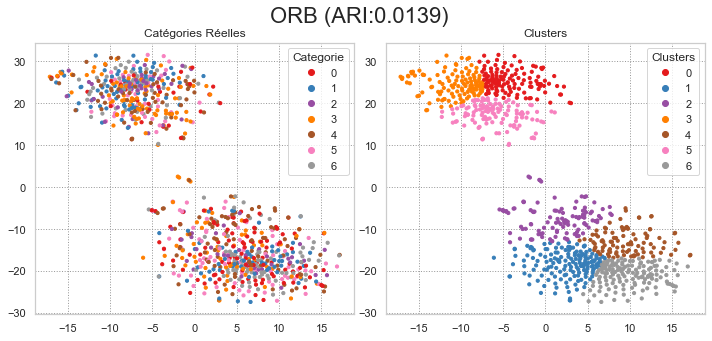

ARI: 0.0139 Time: None


In [86]:
save_features('ORB', features)
evaluate_features('ORB', None ,features, categs, Scores=Scores_image)

### 3.3.2. CNNs (Pre-trained)

Contrairement aux méthodes classiques, les réseaux de neurones convolutifs pré-entrainés sur « ImageNet » permettent d’extraire des features d’images de différents niveaux de complexité, afin de capturer de manière efficace et pertinentes les caractéristiques des images.

In [87]:
def loadCNN(model_type, model_name, mode='Pre-trained'):
    # Charger le modèle pré-entraîné sur ImageNet et sans les couches fully-connected
    model = None
    try:
        model = load_model(models_path+mode+"/"+model_name+"/imagenet") # Création du modèle VGG-16 implementé par Keras
    except:
        model = model_type(weights="imagenet", include_top=False)
        model.save(models_path+mode+"/"+model_name+"/imagenet")

    my_image_models[mode][model_name] = model
    return model

def extractFeatures(model, images):
    features = model.predict(images)
    features = features.reshape((features.shape[0], features.shape[1] * features.shape[2] * features.shape[3]))
    print(features.shape)
    return features

def runModel(model_type, model_name, images, y, mode='Pre-trained', Scores=None):
    print('Loading', model_name, '...')
    model = loadCNN(model_type, model_name)
    
    print(model_name, 'loaded >>> Features extraction...')
    time1 = time.time()
    features = extractFeatures(model, images)
    time2 = np.round(time.time() - time1,0)
    
    save_features(model_name, features)
    print('Features extracted >>> Clustering...')
    evaluate_features(model_name, mode, features, y, Scores, time2)    

#### 3.3.2.1. VGG16

Loading VGG16 ...
VGG16 loaded >>> Features extraction...
33/33 [==============================] - 15s 204ms/step
(1050, 25088)
Features extracted >>> Clustering...


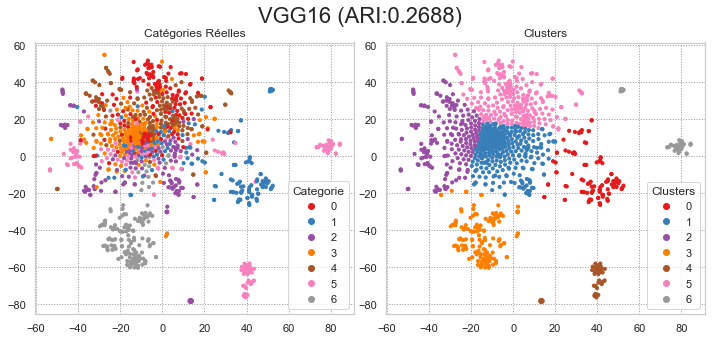

ARI: 0.2688 Time: 19.0


In [88]:
runModel(VGG16, 'VGG16', images, Y, Scores=Scores_image)

#### 3.3.2.2. EfficientNetB0

Loading EfficientNetB0 ...
EfficientNetB0 loaded >>> Features extraction...
33/33 [==============================] - 20s 153ms/step
(1050, 62720)
Features extracted >>> Clustering...


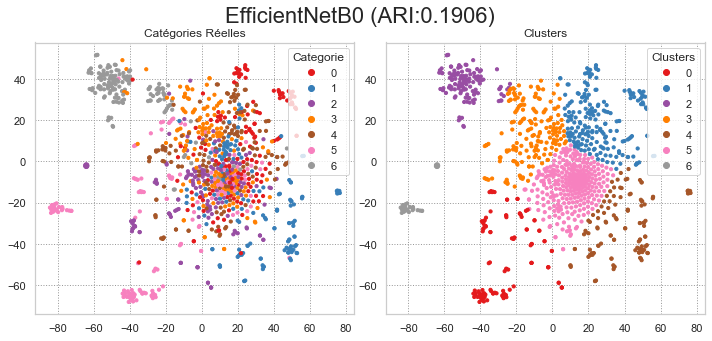

ARI: 0.1906 Time: 21.0


In [89]:
runModel(EfficientNetB0, 'EfficientNetB0', images, Y, Scores=Scores_image)

#### 3.3.2.3. Xception

Loading Xception ...
Xception loaded >>> Features extraction...
33/33 [==============================] - 9s 230ms/step
(1050, 100352)
Features extracted >>> Clustering...


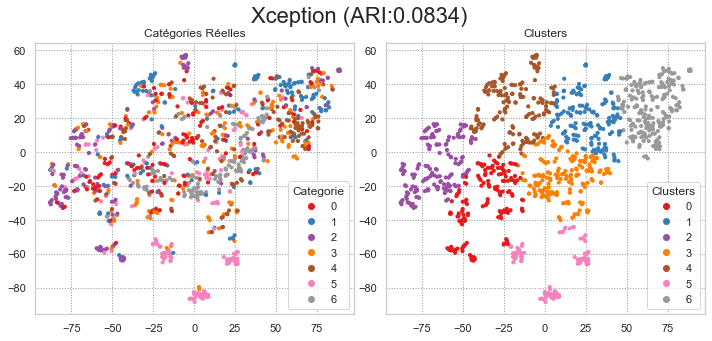

ARI: 0.0834 Time: 11.0


In [90]:
runModel(Xception, 'Xception', images, Y, Scores=Scores_image)

#### 3.3.2.4. ResNet50V2

Loading ResNet50V2 ...
ResNet50V2 loaded >>> Features extraction...
33/33 [==============================] - 5s 99ms/step
(1050, 100352)
Features extracted >>> Clustering...


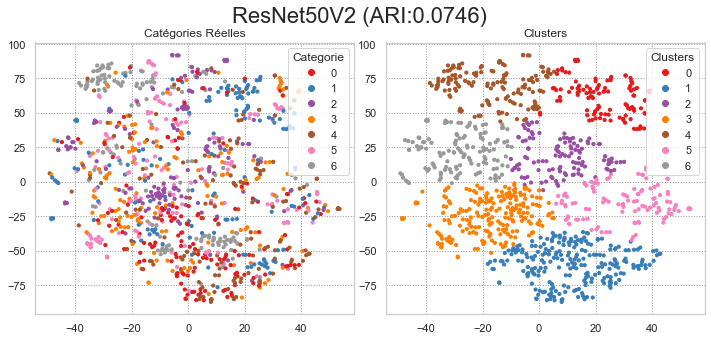

ARI: 0.0746 Time: 6.0


In [91]:
runModel(ResNet50V2, 'ResNet50V2', images, Y, Scores=Scores_image)

#### 3.3.2.5. InceptionV3

Loading InceptionV3 ...
InceptionV3 loaded >>> Features extraction...
33/33 [==============================] - 8s 152ms/step
(1050, 51200)
Features extracted >>> Clustering...


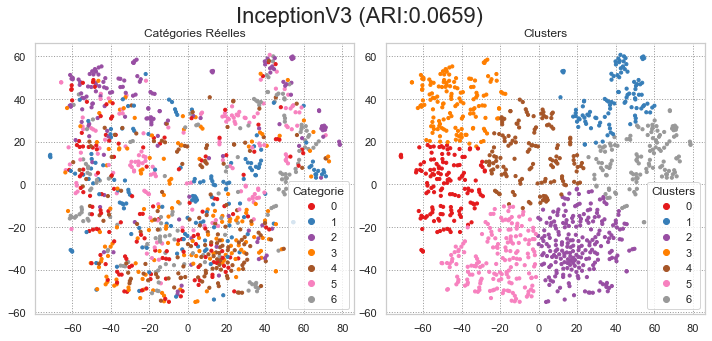

ARI: 0.0659 Time: 9.0


In [92]:
runModel(InceptionV3, 'InceptionV3', images, Y, Scores=Scores_image)

#### 3.3.2.6. MobileNetV2

Loading MobileNetV2 ...
MobileNetV2 loaded >>> Features extraction...
33/33 [==============================] - 3s 49ms/step
(1050, 62720)
Features extracted >>> Clustering...


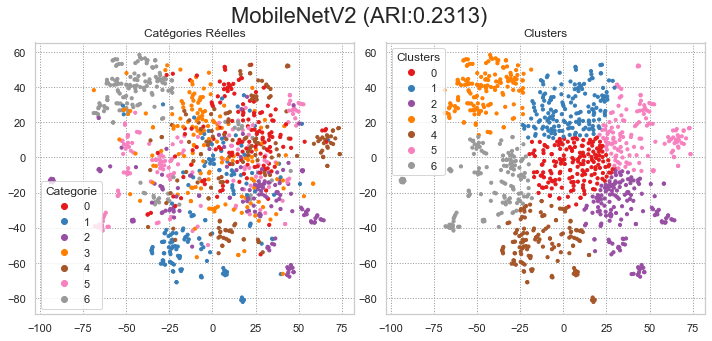

ARI: 0.2313 Time: 4.0


In [93]:
runModel(MobileNetV2, 'MobileNetV2', images, Y, Scores=Scores_image)

### 3.3.3. Comparaison

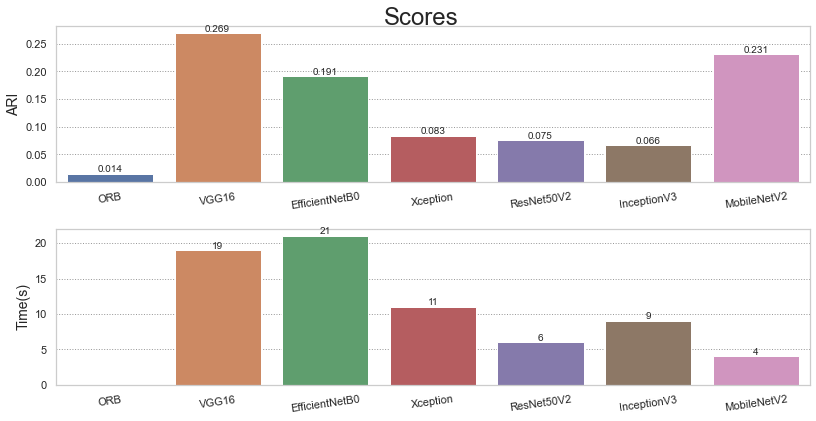

In [94]:
display_scores(Scores_image)

Les modèles CNN sont bien meilleurs que la méthode classique (ORB), en particuliers VGG16, MobileNetV2 et EfficientNetB0.

# 4. Texte & Images

Dans cette partie, les features extraites du texte et des images sont combinées afin améliorer la segmentation des articles.

In [96]:
Scores_combined = pd.DataFrame(columns=['Model', 'ARI', 'hue'], index=[])

## 4.1. Concatenation des Features

La première approche, étant naïves, consiste à simplement concaténer les features des textes et les features des images.

In [97]:
text_features = embeddings['Word2Vec']
img_features = my_features['VGG16']

concat_features = np.concatenate((text_features, img_features), axis=1)
concat_features.shape

(1050, 25288)

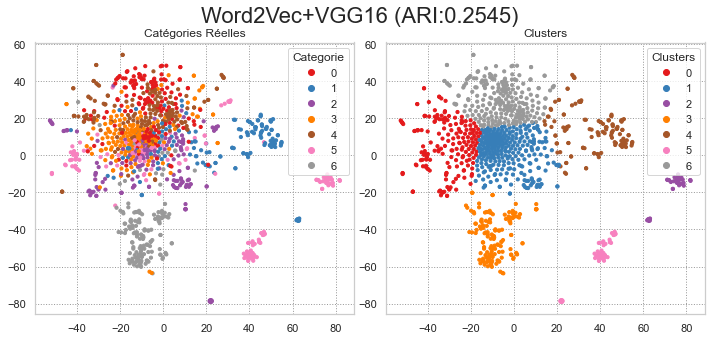

ARI: 0.2545 Time: None


In [98]:
evaluate_features('Word2Vec+VGG16', None, concat_features, Y, Scores=Scores_combined)

In [99]:
text_features = embeddings['USE']
img_features = my_features['MobileNetV2']

concat_features = np.concatenate((text_features, img_features), axis=1)
concat_features.shape

(1050, 63232)

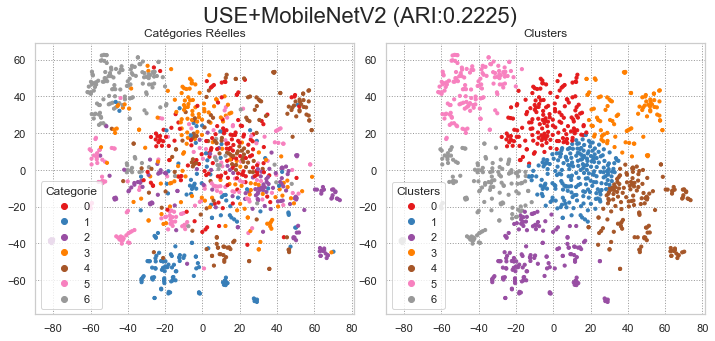

ARI: 0.2225 Time: None


In [100]:
evaluate_features('USE+MobileNetV2', None, concat_features, Y, Scores=Scores_combined)

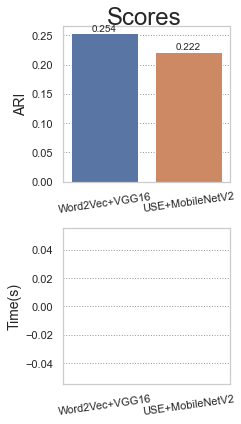

In [101]:
display_scores(Scores_combined)

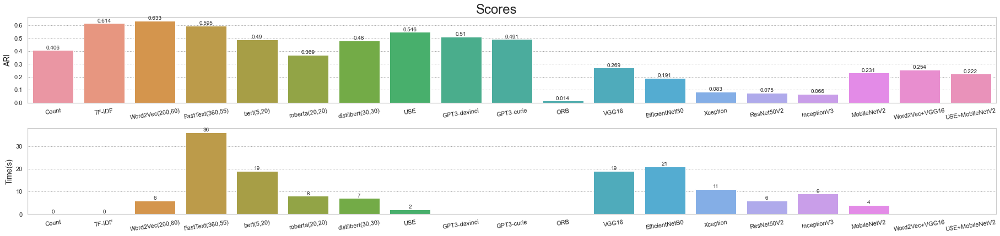

In [102]:
Scores = pd.concat([Scores_text, Scores_image, Scores_combined], ignore_index=True)
display_scores(Scores, yloc=0.93)

La simple concaténation de features n’a non seulement pas amélioré la segmentation des articles, mais l’a dégradé. Il faut donc une approche plus intelligente afin de mieux combiner les features de textes avec les features des images.

## 4.2. Combinaison de Modèles & Fine-Tuning

La deuxième approche, plus subtile, suit le processus suivant :

Préparation des données (texte et images).

In [103]:
X_train, X_val, Y_train, Y_val = trainning_sets(df_images.join(df_corpus['description']), 'categ')

text_train = X_train['description'].tolist()
text_val = X_val['description'].tolist()

images_train = reshapeImageSet(pd.DataFrame(X_train['image']))
Y_train = to_categorical(Y_train, num_classes=n_classes)

images_val = reshapeImageSet(pd.DataFrame(X_val['image']))
Y_val = to_categorical(Y_val, num_classes=n_classes)

sentences = df_corpus['description'].to_list()

Chargements des différents modèles à combiner.

In [104]:
text_input = Input(shape=(), dtype=tf.string, name='text_input')
preprocessing_layer = hub.KerasLayer('https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3', name='text_preprocessing')
encoder_inputs = preprocessing_layer(text_input)
encoder = hub.KerasLayer('https://tfhub.dev/tensorflow/small_bert/bert_en_uncased_L-4_H-512_A-8/1', trainable=False, name='BERT_encoder')
embeds = encoder(encoder_inputs)['sequence_output']
text_features = Flatten(name="text_features")(embeds)
reduced_text_features = Dense(1000, activation='relu', name='reduced_text_features')(text_features)
bert_model = Model(text_input, reduced_text_features)

In [105]:
text_input = Input(shape=(), dtype=tf.string, name='text_input')
preprocessing_layer = hub.KerasLayer('https://tfhub.dev/jeongukjae/distilbert_en_uncased_preprocess/2', name='text_preprocessing')
encoder_inputs = preprocessing_layer(text_input)
encoder = hub.KerasLayer('https://tfhub.dev/jeongukjae/distilbert_en_uncased_L-6_H-768_A-12/1', trainable=False, name='BERT_encoder')
embeds = encoder(encoder_inputs)['sequence_output']
text_features = Flatten(name="text_features")(embeds)
reduced_text_features = Dense(1000, activation='relu', name='reduced_text_features')(text_features)
distilbert_model = Model(text_input, reduced_text_features)

In [106]:
model_type = 'Word2Vec'
vector_size = best_params.loc[best_params['Model']==model_type, 'size'].tolist()[0] if model_type in best_params['Model'].tolist() else 200
max_length = best_params.loc[best_params['Model']==model_type, 'max_length'].tolist()[0] if model_type in best_params['Model'].tolist() else 60

model = gensim.models.Word2Vec(min_count=1, window=5, vector_size=vector_size, seed=0, workers=cpu_count())

model.build_vocab(sentences)
model.train(sentences, total_examples=model.corpus_count, epochs=100)
model_vectors = model.wv
words = model_vectors.index_to_key

# Préparation des sentences (tokenization)
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
def tokenPad(text):
    return pad_sequences(tokenizer.texts_to_sequences(text),
                                                    maxlen=max_length,
                                                    padding='post') 

num_words = len(tokenizer.word_index) + 1

# Création de la matrice d'embedding
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, vector_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)

# Création du modèle
word_input=Input(shape=(max_length,),dtype='float64', name='text_input')  
word_embedding=Embedding(input_dim=vocab_size,
                        output_dim=vector_size,
                        weights = [embedding_matrix],
                        input_length=max_length, 
                        name='text_features')(word_input)
word_vec=GlobalAveragePooling1D(name='reduce_text_features')(word_embedding)  
word2vec_model = Model([word_input],word_vec)

for layer in word2vec_model.layers:
	layer.trainable = False

In [107]:
images_model = loadCNN(VGG16, 'VGG16')
# Geler le modèle
for layer in images_model.layers:
	layer.trainable = False

vgg16_model = Sequential([
    Input(shape=(224, 224, 3), name='image_input'),
    images_model,
    Flatten(name="image_features"),
    Dense(1000, activation='relu', name='reduced_image_features')
])

In [108]:
images_model = loadCNN(MobileNetV2, 'MobileNetV2')
# Geler le modèle
for layer in images_model.layers:
	layer.trainable = False

mobilenetv2_model = Sequential([
    Input(shape=(224, 224, 3), name='image_input'),
    images_model,
    Flatten(name="image_features"),
    Dense(1000, activation='relu', name='reduced_image_features')
])

Les modèles exploités précédemment, peuvent être ré-entrainés pour s’adapter à notre data set. Cela se fait en :
<ul>
    <li>Ajouter, au modèle de base, une nouvelle tête (couches de sorties) de classification ;</li>
    <li>Entrainer le nouveau modèle sur le data set, en entrainant lentement la tête tout en figeant les poids du modèle de base ; </li>
    <li>Couper la tête (sortie) ;</li>
</ul>
<p>Cela à l’avantage d’exploiter les capacité d’extractions de features par les modèles de base (pré-entrainés) pour construire un nouveau modèle plus efficace sur notre dataset à bas coût (coût d’entrainement de la nouvelle tête).</p>

In [109]:
combined_models = {}

# Fonction de concatenation des modèles
def combineModels(text_model, images_model, combined_model_name='combined_model'):
    global combined_models
    
    combinedInput = concatenate([text_model.output, images_model.output], name='concat_features')
    x = Dense(700, activation=None, name='combined_features')(combinedInput)
    x = Dense(n_classes, activation='softmax', name='class')(x)

    combined_model = Model(inputs=[text_model.input, images_model.input], outputs=x, name=combined_model_name)
    combined_models[combined_model_name] = combined_model

    display(plot_model(combined_model, show_shapes=False, show_dtype=False))
    
    return combined_model


def fineTune(model, X_train, y_train, X_val, y_val, epochs=100, batch_size=32, learning_rate=1e-4, verbose=2):
    # Compiler le modèle 
    model.compile(loss="categorical_crossentropy", optimizer=optimizers.SGD(learning_rate=learning_rate, momentum=0.9), metrics=["accuracy"])
    model.summary()

    # Configurer le GPU pour éviter des fuites mémoires
    config = ConfigProto()
    config.gpu_options.per_process_gpu_memory_fraction = 0.5
    config.gpu_options.allow_growth = True    
    session = InteractiveSession(config=config)
    elapsed = None
    try:   
        # Entraîner sur les données d'entraînement 
        time1 = time.time()
        model_infos = model.fit(x=X_train, y=y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, verbose=verbose, workers=cpu_count())            
        elapsed = np.round(time.time() - time1,0)
        
        plot_hist(model_infos, "accuracy", "val_accuracy")          
    except:
        traceback.print_exc()
    
    tf.keras.backend.clear_session()
    InteractiveSession().close()
    del session
    gc.collect()     

    return elapsed

### 4.2.1. Word2Vec + VGG16

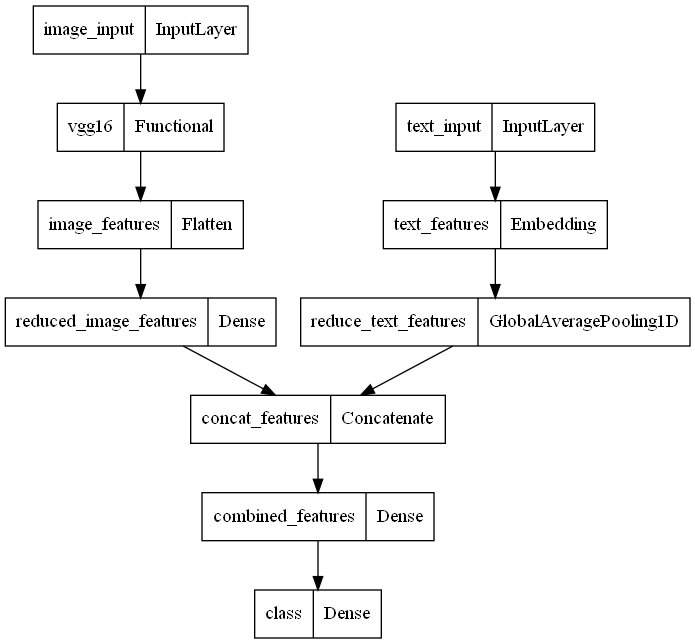

In [117]:
text_model = word2vec_model
images_model = vgg16_model
combined_model_name = 'Word2Vec-VGG16'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "Word2Vec-VGG16"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 text_input (InputLayer)        [(None, 60)]         0           []                               
                                                                                                  
 vgg16 (Functional)             (None, None, None,   14714688    ['image_input[0][0]']            
                                512)                                                              
                                                                                     

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 13s - loss: 5.0860 - accuracy: 0.6988 - val_loss: 5.2006 - val_accuracy: 0.8095 - 13s/epoch - 474ms/step
Epoch 2/20
27/27 - 9s - loss: 0.2573 - accuracy: 0.9762 - val_loss: 4.5831 - val_accuracy: 0.7905 - 9s/epoch - 349ms/step
Epoch 3/20
27/27 - 10s - loss: 0.0074 - accuracy: 0.9964 - val_loss: 4.6887 - val_accuracy: 0.7905 - 10s/epoch - 355ms/step
Epoch 4/20
27/27 - 9s - loss: 0.0050 - accuracy: 0.9988 - val_loss: 4.5682 - val_accuracy: 0.7905 - 9s/epoch - 340ms/step
Epoch 5/20
27/27 - 9s - loss: 1.0029e-05 - accuracy: 1.0000 - val_loss: 4.5321 - val_accuracy: 0.7952 - 9s/epoch - 337ms/step
Epoch 6/20
27/27 - 9s - loss: 1.6971e-05 - accuracy: 1.0000 - val_loss: 4.5317 - val_accuracy: 0.7952 - 9s/epoch - 341ms/step
Epoch 7/20
27/27 - 10s - loss: 1.3482e-05 - accuracy: 1.0000 - val_loss: 4.5319 - val_accuracy: 0.7952 - 10s/epoch - 384ms/step
Epoch 8/20
27/27 - 9s - loss: 1.0999e-05 - accuracy: 1.0000 - val_loss: 4.5318 - val_accuracy: 0.7952 - 9s/epoch - 338ms/step
Ep

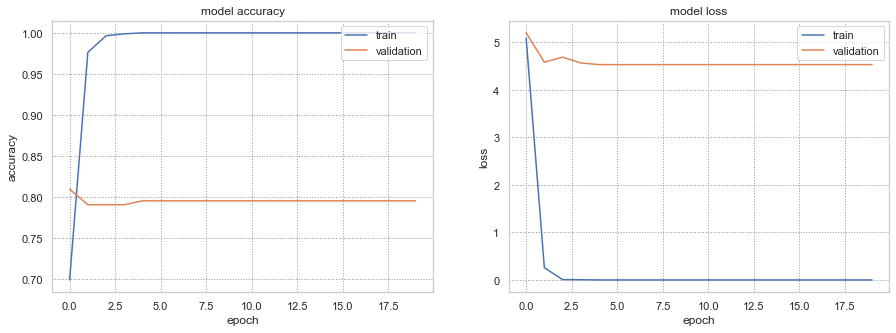

In [118]:
elapsed = fineTune(combined_model, [tokenPad(text_train), images_train], Y_train, [tokenPad(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 6s 162ms/step


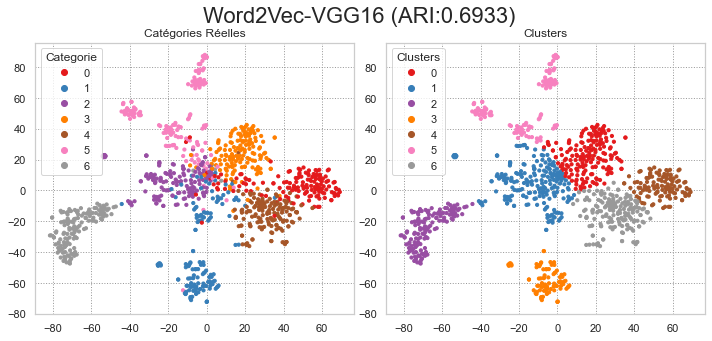

ARI: 0.6933 Time: 176.0


In [119]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tokenPad(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.2. BERT + VGG16

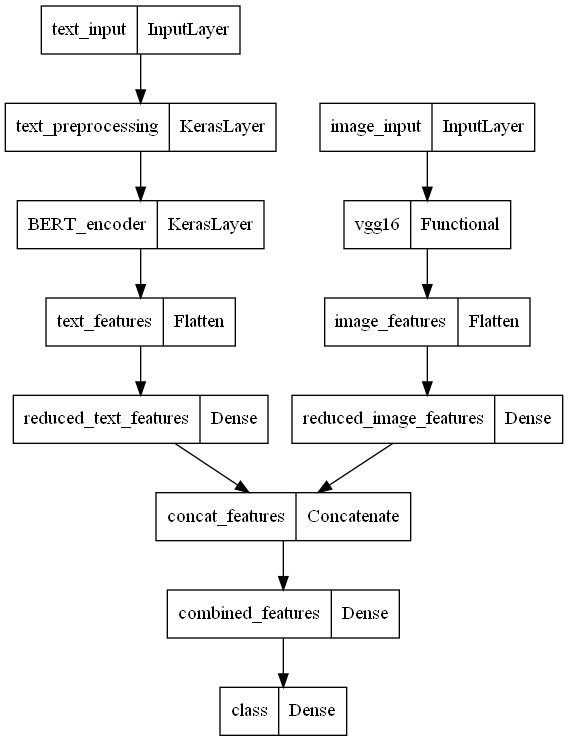

In [121]:
text_model = bert_model
images_model = vgg16_model
combined_model_name = 'BERT-VGG16'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "BERT-VGG16"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 text_input (InputLayer)        [(None,)]            0           []                               
                                                                                                  
 text_preprocessing (KerasLayer  {'input_mask': (Non  0          ['text_input[0][0]']             
 )                              e, 128),                                                          
                                 'input_word_ids':                                                
                                (None, 128),                                                      
                                 'input_type_ids':                                                
                                (None, 128)}                                             

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 23s - loss: 3.3668 - accuracy: 0.7464 - val_loss: 3.7106 - val_accuracy: 0.7905 - 23s/epoch - 867ms/step
Epoch 2/20
27/27 - 14s - loss: 0.1059 - accuracy: 0.9881 - val_loss: 3.5769 - val_accuracy: 0.7810 - 14s/epoch - 516ms/step
Epoch 3/20
27/27 - 16s - loss: 1.8164e-04 - accuracy: 1.0000 - val_loss: 3.4429 - val_accuracy: 0.7952 - 16s/epoch - 593ms/step
Epoch 4/20
27/27 - 15s - loss: 1.0329e-04 - accuracy: 1.0000 - val_loss: 3.4433 - val_accuracy: 0.7952 - 15s/epoch - 563ms/step
Epoch 5/20
27/27 - 14s - loss: 5.1240e-05 - accuracy: 1.0000 - val_loss: 3.4473 - val_accuracy: 0.7952 - 14s/epoch - 536ms/step
Epoch 6/20
27/27 - 15s - loss: 3.8349e-05 - accuracy: 1.0000 - val_loss: 3.4487 - val_accuracy: 0.7952 - 15s/epoch - 559ms/step
Epoch 7/20
27/27 - 14s - loss: 3.4732e-05 - accuracy: 1.0000 - val_loss: 3.4514 - val_accuracy: 0.7952 - 14s/epoch - 535ms/step
Epoch 8/20
27/27 - 14s - loss: 2.8479e-05 - accuracy: 1.0000 - val_loss: 3.4526 - val_accuracy: 0.7952 - 14s/epo

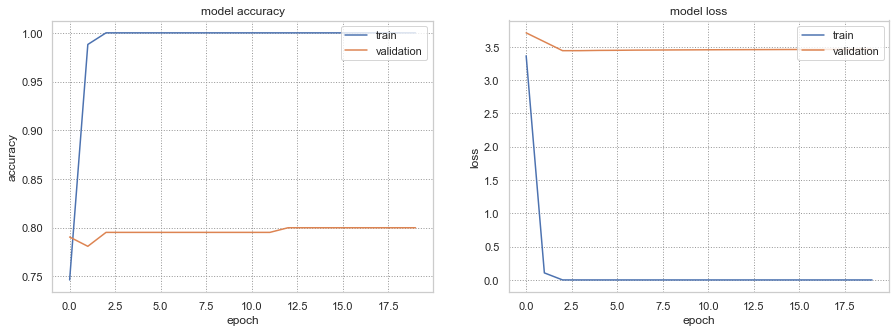

In [122]:
elapsed = fineTune(combined_model, [tf.constant(text_train), images_train], Y_train, [tf.constant(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 15s 415ms/step


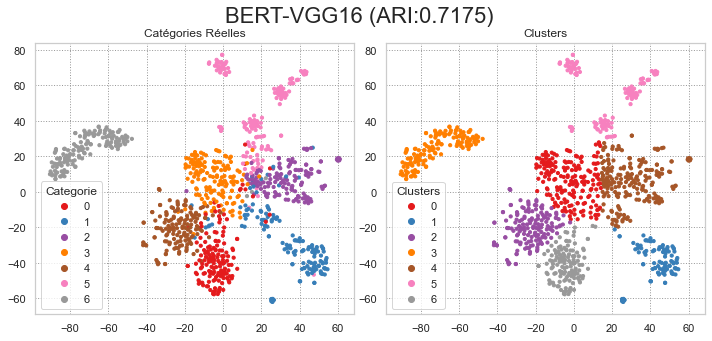

ARI: 0.7175 Time: 312.0


In [123]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tf.constant(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.3. DistilBERT + VGG16

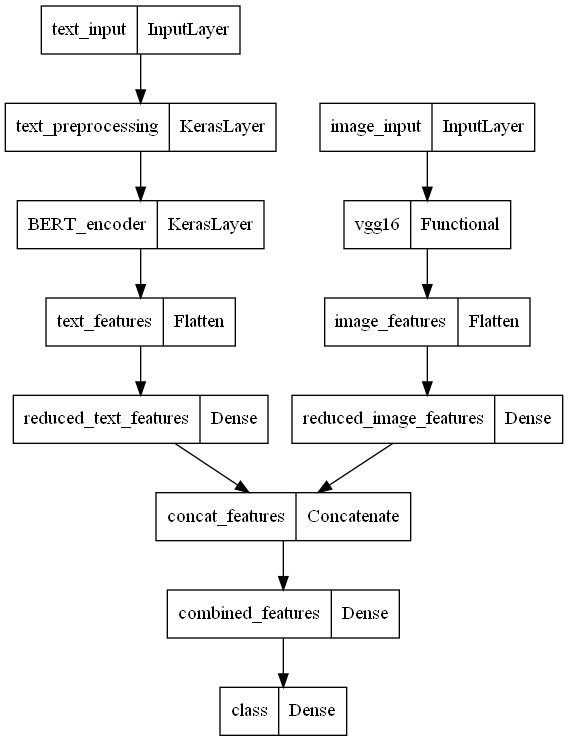

In [133]:
text_model = distilbert_model
images_model = vgg16_model
combined_model_name = 'DistilBERT-VGG16'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "DistilBERT-VGG16"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 text_input (InputLayer)        [(None,)]            0           []                               
                                                                                                  
 text_preprocessing (KerasLayer  {'input_mask': (Non  0          ['text_input[0][0]']             
 )                              e, 128),                                                          
                                 'input_word_ids':                                                
                                (None, 128)}                                                      
                                                                                                  
 image_input (InputLayer)       [(None, 224, 224, 3  0           []                

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 32s - loss: 2.5631 - accuracy: 0.7524 - val_loss: 3.5864 - val_accuracy: 0.7857 - 32s/epoch - 1s/step
Epoch 2/20
27/27 - 18s - loss: 0.0428 - accuracy: 0.9952 - val_loss: 3.9640 - val_accuracy: 0.8095 - 18s/epoch - 659ms/step
Epoch 3/20
27/27 - 18s - loss: 1.9862e-04 - accuracy: 1.0000 - val_loss: 3.8936 - val_accuracy: 0.8143 - 18s/epoch - 668ms/step
Epoch 4/20
27/27 - 18s - loss: 3.5632e-05 - accuracy: 1.0000 - val_loss: 3.8873 - val_accuracy: 0.8143 - 18s/epoch - 657ms/step
Epoch 5/20
27/27 - 17s - loss: 3.0193e-05 - accuracy: 1.0000 - val_loss: 3.8861 - val_accuracy: 0.8143 - 17s/epoch - 642ms/step
Epoch 6/20
27/27 - 17s - loss: 2.7908e-05 - accuracy: 1.0000 - val_loss: 3.8850 - val_accuracy: 0.8143 - 17s/epoch - 631ms/step
Epoch 7/20
27/27 - 17s - loss: 2.6096e-05 - accuracy: 1.0000 - val_loss: 3.8843 - val_accuracy: 0.8143 - 17s/epoch - 646ms/step
Epoch 8/20
27/27 - 18s - loss: 2.4799e-05 - accuracy: 1.0000 - val_loss: 3.8832 - val_accuracy: 0.8143 - 18s/epoch 

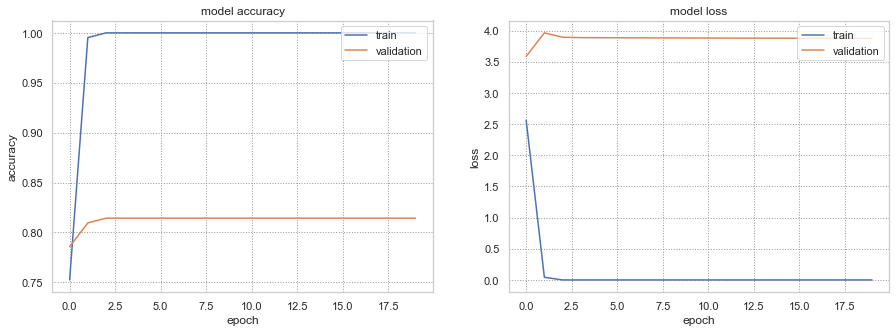

In [134]:
elapsed = fineTune(combined_model, [tf.constant(text_train), images_train], Y_train, [tf.constant(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 20s 511ms/step


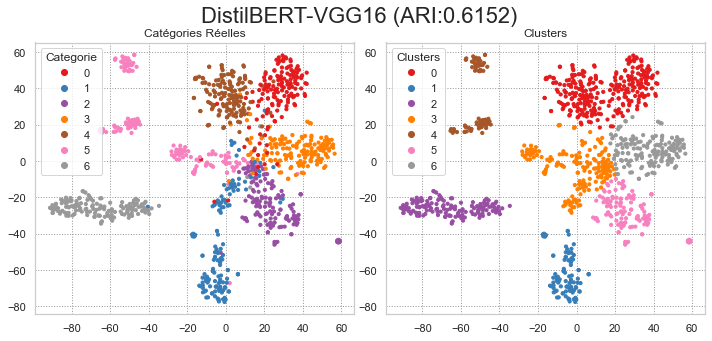

ARI: 0.6152 Time: 398.0


In [135]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tf.constant(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.4. Word2Vec + MobileNetV2

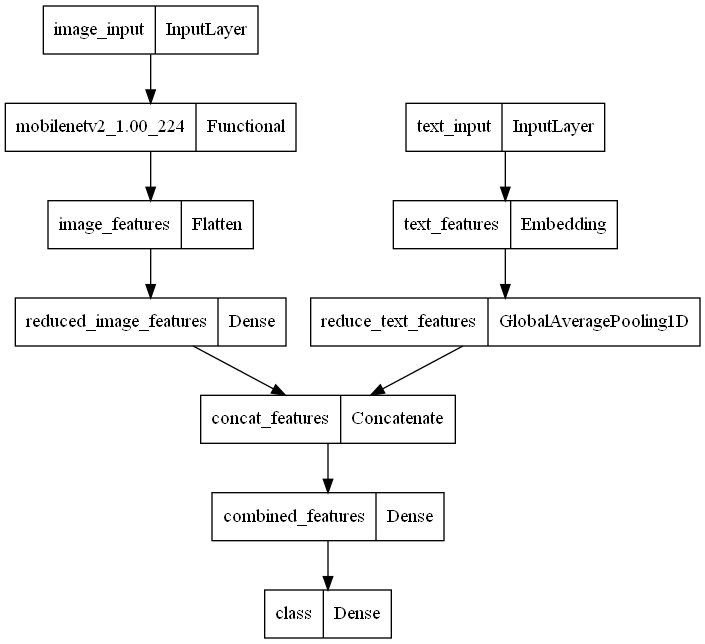

In [137]:
text_model = word2vec_model
images_model = mobilenetv2_model
combined_model_name = 'Word2Vec-MobileNetV2'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "Word2Vec-MobileNetV2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 text_input (InputLayer)        [(None, 60)]         0           []                               
                                                                                                  
 mobilenetv2_1.00_224 (Function  (None, None, None,   2257984    ['image_input[0][0]']            
 al)                            1280)                                                             
                                                                               

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 11s - loss: 1.8757 - accuracy: 0.3917 - val_loss: 1.3406 - val_accuracy: 0.5571 - 11s/epoch - 415ms/step
Epoch 2/20
27/27 - 2s - loss: 0.4396 - accuracy: 0.8548 - val_loss: 1.1250 - val_accuracy: 0.6143 - 2s/epoch - 73ms/step
Epoch 3/20
27/27 - 2s - loss: 0.1299 - accuracy: 0.9917 - val_loss: 1.0552 - val_accuracy: 0.6524 - 2s/epoch - 73ms/step
Epoch 4/20
27/27 - 2s - loss: 0.0664 - accuracy: 0.9976 - val_loss: 1.0414 - val_accuracy: 0.6667 - 2s/epoch - 69ms/step
Epoch 5/20
27/27 - 2s - loss: 0.0449 - accuracy: 1.0000 - val_loss: 1.0303 - val_accuracy: 0.6714 - 2s/epoch - 71ms/step
Epoch 6/20
27/27 - 2s - loss: 0.0350 - accuracy: 1.0000 - val_loss: 1.0348 - val_accuracy: 0.6619 - 2s/epoch - 77ms/step
Epoch 7/20
27/27 - 2s - loss: 0.0291 - accuracy: 1.0000 - val_loss: 1.0276 - val_accuracy: 0.6667 - 2s/epoch - 75ms/step
Epoch 8/20
27/27 - 2s - loss: 0.0248 - accuracy: 1.0000 - val_loss: 1.0315 - val_accuracy: 0.6714 - 2s/epoch - 75ms/step
Epoch 9/20
27/27 - 2s - loss:

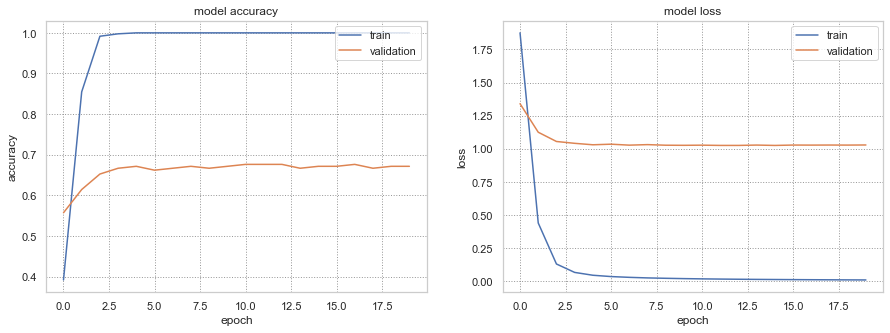

In [138]:
elapsed = fineTune(combined_model, [tokenPad(text_train), images_train], Y_train, [tokenPad(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 3s 47ms/step


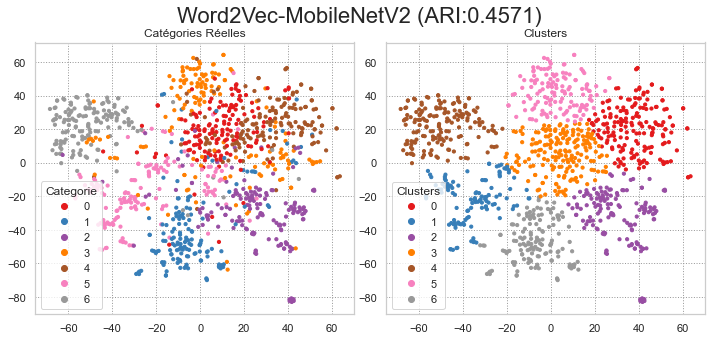

ARI: 0.4571 Time: 51.0


In [139]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tokenPad(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.5. BERT + MobileNetV2

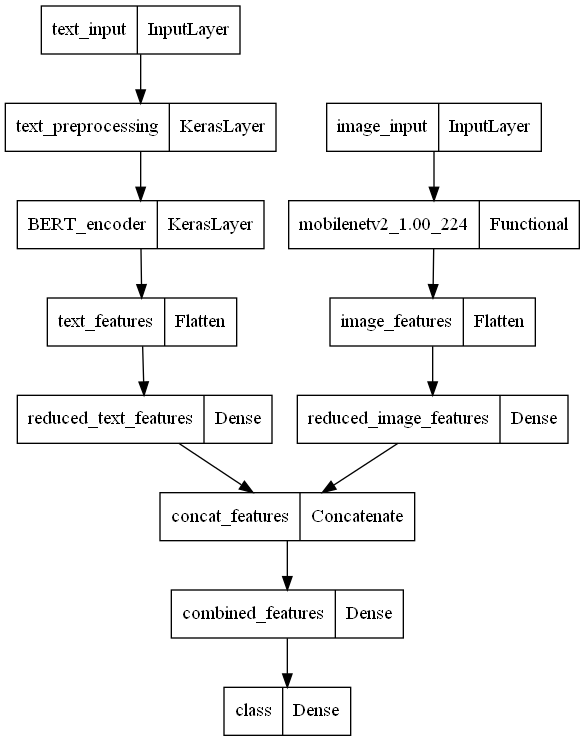

In [141]:
text_model = bert_model
images_model = mobilenetv2_model
combined_model_name = 'BERT-MobileNetV2'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "BERT-MobileNetV2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 text_input (InputLayer)        [(None,)]            0           []                               
                                                                                                  
 text_preprocessing (KerasLayer  {'input_mask': (Non  0          ['text_input[0][0]']             
 )                              e, 128),                                                          
                                 'input_word_ids':                                                
                                (None, 128),                                                      
                                 'input_type_ids':                                                
                                (None, 128)}                                       

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 27s - loss: 1.6606 - accuracy: 0.4607 - val_loss: 0.8174 - val_accuracy: 0.6952 - 27s/epoch - 1s/step
Epoch 2/20
27/27 - 22s - loss: 0.2237 - accuracy: 0.9298 - val_loss: 0.6755 - val_accuracy: 0.7762 - 22s/epoch - 814ms/step
Epoch 3/20
27/27 - 23s - loss: 0.0629 - accuracy: 0.9976 - val_loss: 0.5889 - val_accuracy: 0.7714 - 23s/epoch - 868ms/step
Epoch 4/20
27/27 - 24s - loss: 0.0341 - accuracy: 1.0000 - val_loss: 0.5788 - val_accuracy: 0.7857 - 24s/epoch - 898ms/step
Epoch 5/20
27/27 - 19s - loss: 0.0237 - accuracy: 1.0000 - val_loss: 0.5748 - val_accuracy: 0.7905 - 19s/epoch - 711ms/step
Epoch 6/20
27/27 - 25s - loss: 0.0194 - accuracy: 1.0000 - val_loss: 0.5627 - val_accuracy: 0.7810 - 25s/epoch - 940ms/step
Epoch 7/20
27/27 - 26s - loss: 0.0169 - accuracy: 1.0000 - val_loss: 0.5599 - val_accuracy: 0.8095 - 26s/epoch - 957ms/step
Epoch 8/20
27/27 - 35s - loss: 0.0148 - accuracy: 1.0000 - val_loss: 0.5548 - val_accuracy: 0.8095 - 35s/epoch - 1s/step
Epoch 9/20
27/

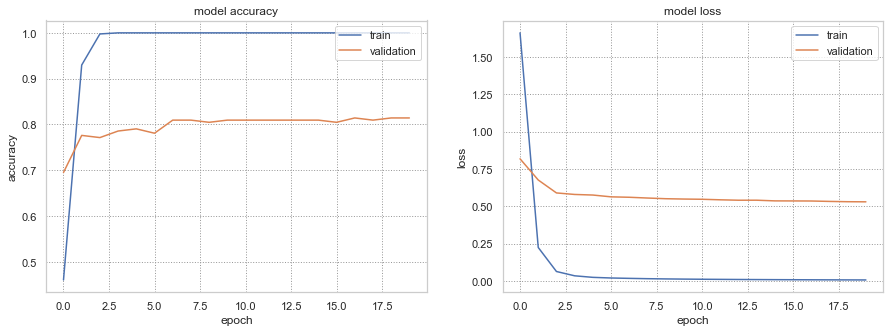

In [142]:
elapsed = fineTune(combined_model, [tf.constant(text_train), images_train], Y_train, [tf.constant(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 16s 424ms/step


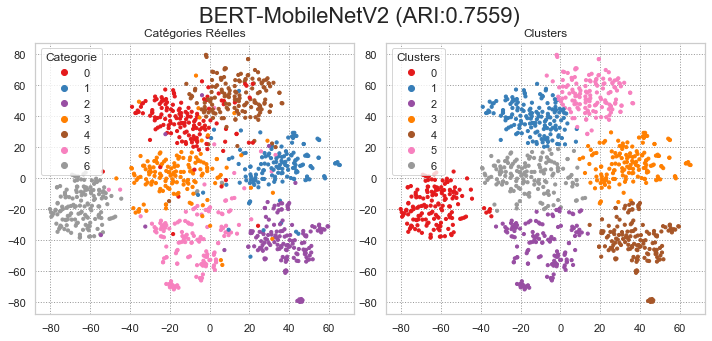

ARI: 0.7559 Time: 452.0


In [143]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tf.constant(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.6. DistilBERT + MobileNetV2

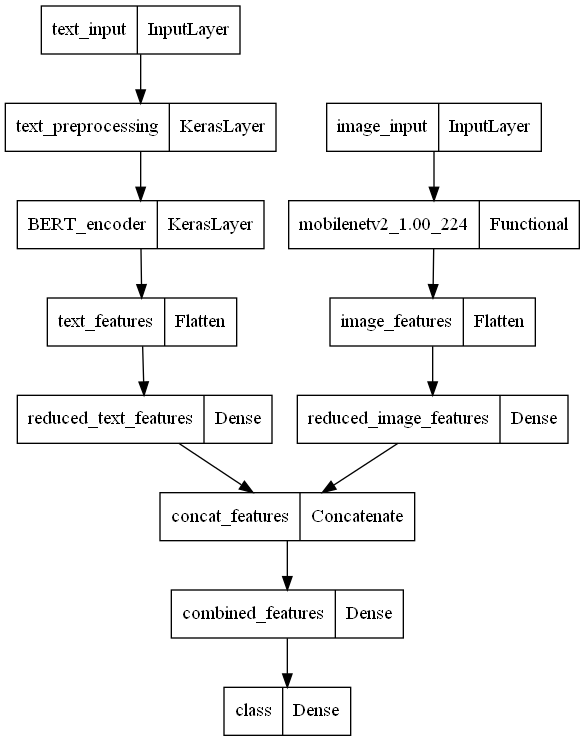

In [145]:
text_model = distilbert_model
images_model = mobilenetv2_model
combined_model_name = 'DistliBERT-MobileNetV2'
combineModels(text_model, images_model, combined_model_name)
combined_model = combined_models[combined_model_name]

Model: "DistliBERT-MobileNetV2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 text_input (InputLayer)        [(None,)]            0           []                               
                                                                                                  
 text_preprocessing (KerasLayer  {'input_mask': (Non  0          ['text_input[0][0]']             
 )                              e, 128),                                                          
                                 'input_word_ids':                                                
                                (None, 128)}                                                      
                                                                                                  
 image_input (InputLayer)       [(None, 224, 224, 3  0           []          

c:\Python39\lib\site-packages\tensorflow\python\client\session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch 1/20
27/27 - 39s - loss: 1.6621 - accuracy: 0.4179 - val_loss: 0.9938 - val_accuracy: 0.6571 - 39s/epoch - 1s/step
Epoch 2/20
27/27 - 21s - loss: 0.3106 - accuracy: 0.9119 - val_loss: 0.8194 - val_accuracy: 0.7095 - 21s/epoch - 777ms/step
Epoch 3/20
27/27 - 21s - loss: 0.1241 - accuracy: 0.9857 - val_loss: 0.7528 - val_accuracy: 0.7286 - 21s/epoch - 760ms/step
Epoch 4/20
27/27 - 20s - loss: 0.0630 - accuracy: 0.9988 - val_loss: 0.7249 - val_accuracy: 0.7333 - 20s/epoch - 737ms/step
Epoch 5/20
27/27 - 22s - loss: 0.0454 - accuracy: 1.0000 - val_loss: 0.7092 - val_accuracy: 0.7381 - 22s/epoch - 800ms/step
Epoch 6/20
27/27 - 24s - loss: 0.0344 - accuracy: 1.0000 - val_loss: 0.7063 - val_accuracy: 0.7476 - 24s/epoch - 881ms/step
Epoch 7/20
27/27 - 22s - loss: 0.0290 - accuracy: 1.0000 - val_loss: 0.7070 - val_accuracy: 0.7524 - 22s/epoch - 831ms/step
Epoch 8/20
27/27 - 31s - loss: 0.0251 - accuracy: 1.0000 - val_loss: 0.7039 - val_accuracy: 0.7524 - 31s/epoch - 1s/step
Epoch 9/20
27/

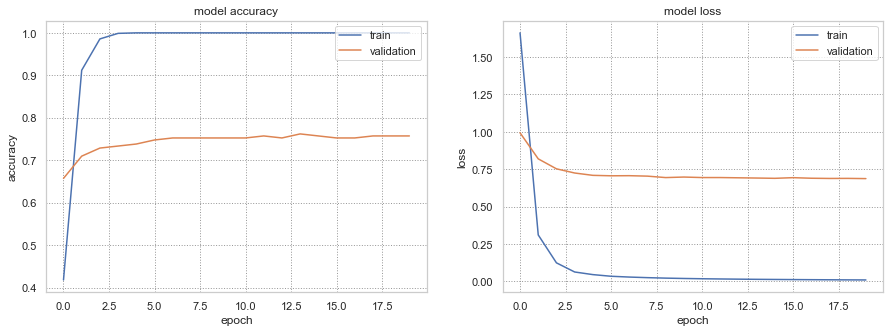

In [146]:
elapsed = fineTune(combined_model, [tf.constant(text_train), images_train], Y_train, [tf.constant(text_val), images_val], Y_val, learning_rate=1e-4, epochs=20)

33/33 [==============================] - 17s 392ms/step


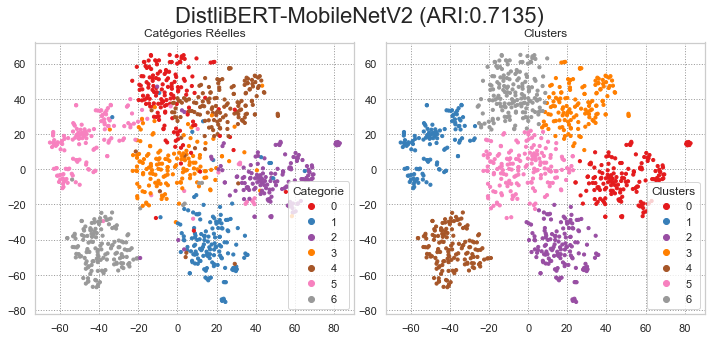

ARI: 0.7135 Time: 407.0


In [147]:
combined_encoder = Model(inputs=[text_model.input, images_model.input], outputs=combined_model.get_layer('combined_features').output, name='combined_encoder')
combined_features = combined_encoder.predict([tf.constant(sentences), images])
evaluate_features(combined_model_name, None, combined_features, Y, Scores=Scores_combined, time=elapsed)

### 4.2.7. Comparaison

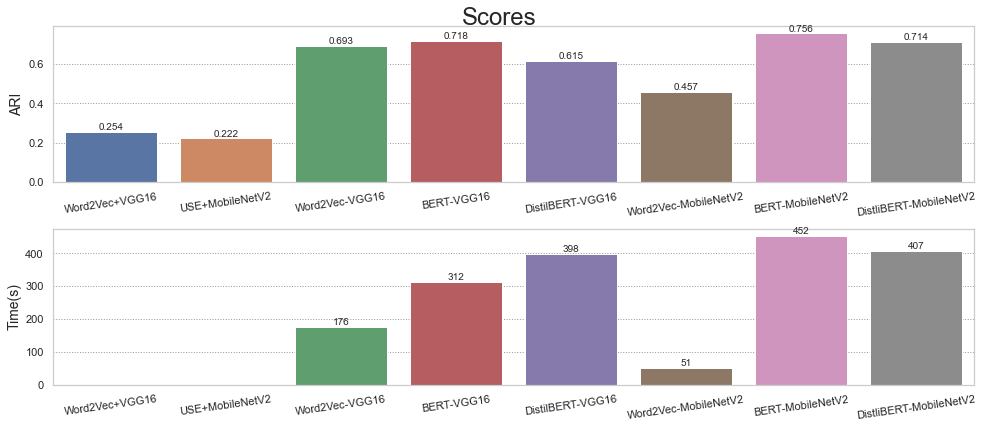

In [148]:
display_scores(Scores_combined)

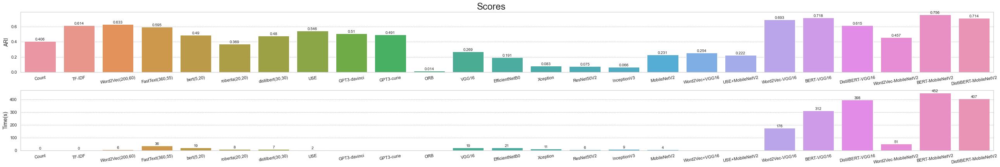

In [149]:
Scores = pd.concat([Scores_text, Scores_image, Scores_combined], ignore_index=True)
display_scores(Scores, yloc=0.93)

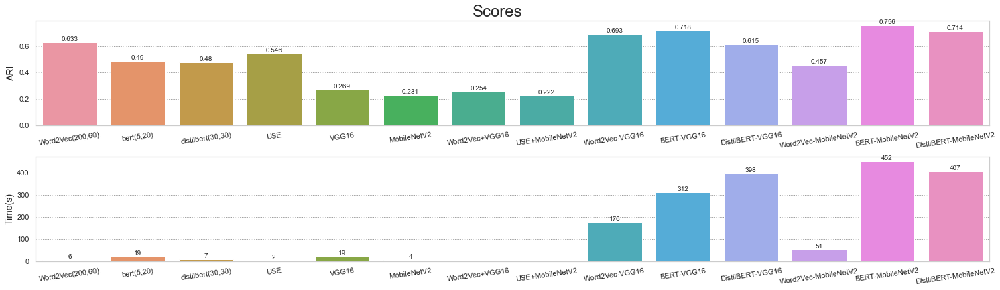

In [159]:
display_scores(Scores[Scores['Model'].isin(['Word2Vec(200,60)', 'bert(5,20)',  'distilbert(30,30)', 'USE', 'VGG16', 'MobileNetV2', 'Word2Vec+VGG16', 'USE+MobileNetV2', 'Word2Vec-VGG16', 'BERT-VGG16', 'DistilBERT-VGG16', 'Word2Vec-MobileNetV2', 'BERT-MobileNetV2', 'DistliBERT-MobileNetV2'])], yloc=0.93)

Combiner les meilleurs modèles (Word2Vec et VGG16) donnerait à priori les meilleurs résultats. Or, ce sont des modèles moins bien performants individuellement, en particulier BERT et MobileNetV2, qui une fois combinés surpassent tous les autres modèles. 

# Conclusion

D’après les différents tests effectués sur notre data set on peut conclure que :
<ul>    
    <li>Comparés aux méthodes classiques, les modèles RNs (réseaux de neurones) arrivent à mieux capturer les caractéristiques (features) des données, et ce avec des niveaux de finesse différents (plus efficients) ;</li>
    <li>La segmentation à base de textes est meilleure que celle à base d’images ;</li>
    <li>La segmentation combinant des modèles de textes et des modèles d’images offre les meilleurs résultats, et ce après une phase d’ajustement au data set ;</li>
</ul>

Finalement grâce à l’aboutissement d’une bonne segmentation (<em>ARI : 0.756</em> avec <em>BERT-MobileNetV2</em>) des articles présents dans le data set, cette étude montre la faisabilité d’un classifieur automatique d’articles (sur les catégories de niveau 1). De plus, les performances d’un tel classifieur pourraient être optimisées si :
<ul>    
    <li>Les données sont mieux prétraitées :
        <ul>            
            <li>Elimination des phrases similaires dans les descriptions (redondance) ;</li>
            <li>Augmentation des images (rotation, changement d’echelles…) ;</li>
        </ul>
    </li>
    <li>Le modèle est mieux ajusté (fine-tuned), avec des techniques plus avancées comme les « adapter-transformers ».</li>
</ul>